# Airlines Customer Segmentation Using Recency, Frequency, and Monetary (RFM) Model with K-Means

### Assignment Points
1. Use dataset flight.csv : https://drive.google.com/file/d/1oZKjctosUWBoFpMi99Zavdhijf3n0Go_/view?usp=sharing
2. Follow the instructions in the assignment points

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
%matplotlib inline

# Set the maximum number of columns and rows to display to a large number
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [2]:
# connect to drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# import data
df = pd.read_csv("/content/drive/MyDrive/Bootcamp/Day 15 - Case Study 4 RFM Analysis with K-Means/flight.csv")
df.shape

(62988, 23)

## Data Dictionary
1. member_no    : ID Member
2. ffp_date     : Frequent Flyer Program Join Date
3. first_flight_date : Frist Flight Date
4. gender      : Gender
5. ffp_tier    : Tier of Frequent Flyer Program
6. work_city   : City
7. work_province : Province
8. work_country : Country
9. age         : Customer Age
10. load_time  : The date data was retrieved
11. flight_count : Customer flight count
12. bp_sum     : Flight plan
13. sum_yr_1   : Fare revenue (the money made from selling flight tickets to the member in year 1)
14. sum_yr_2   : Votes prices (the revenue from ancillary services or possibly loyalty program activities in year 2)
15. seg_km_sum : Total distance (km) traveled
16. last_flight_date : Last flight date
17. last_to_end : Distance of the last flight to the last airline company
18. avg_interval : Averange time distance
19. max_interval : Maximum time intervals
20. exchange_count :Exchange amount
21. avg_discount : Averange discount
22. points_sum   : Customer point
23. point_notflight : Not used customer point

## Assignment 1: From the 3 datasets above, just choose one
1. Understand the selected dataset by checking the dataset using: info(), sample(5), head(), tail() and looking at the value counts in each column.


In [4]:
df.head(5)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,210,505308,239560.0,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,140,362480,171483.0,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,135,351159,163618.0,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,23,337314,116350.0,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,152,273844,124560.0,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


In [5]:
df.tail(5)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
62983,18375,5/20/2011,6/5/2013,Female,4,guangzhou,guangdong,CN,25.0,3/31/2014,2,0,0.0,0.0,1134,6/9/2013,297,4.0,4,1,0.0,12318,22
62984,36041,3/8/2010,9/14/2013,Male,4,foshan,guangdong,CN,38.0,3/31/2014,4,0,0.0,0.0,8016,1/3/2014,89,37.0,60,14,0.0,106972,43
62985,45690,3/30/2006,12/2/2006,Female,4,guangzhou,guangdong,CN,43.0,3/31/2014,2,0,0.0,0.0,2594,3/3/2014,29,166.0,166,0,0.0,0,0
62986,61027,2/6/2013,2/14/2013,Female,4,guangzhou,guangdong,CN,36.0,3/31/2014,2,0,0.0,0.0,3934,2/26/2013,400,12.0,12,0,0.0,0,0
62987,61340,2/17/2013,2/17/2013,Female,4,shanghai,.,CN,29.0,3/31/2014,2,0,NaN,0.0,4222,2/23/2013,403,6.0,6,0,0.0,0,0


In [6]:
df.sample(5)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
22434,19189,1/1/2007,1/26/2007,Male,4,taicang,jiangsu,CN,62.0,3/31/2014,13,6935,1733.0,1980.0,17359,12/20/2013,103,49.416667,181,0,0.624852,6935,0
7502,37785,8/16/2012,8/16/2012,Male,4,shanghai,shanghai,CN,30.0,3/31/2014,23,26835,12352.0,13764.0,30084,11/30/2013,123,21.409091,134,0,0.886957,26835,0
32566,32438,3/29/2012,7/29/2013,Male,4,.,beijing,CN,51.0,3/31/2014,3,6868,0.0,5967.0,6163,10/16/2013,168,39.500000,73,0,1.076390,8040,1
12328,2586,7/11/2008,7/11/2008,Male,4,shantou,guangdong,CN,48.0,3/31/2014,26,16319,5239.0,13379.0,27281,2/17/2014,44,27.440000,305,0,0.685454,16319,0
30233,34061,10/2/2012,10/2/2012,Female,4,haerbin,heilongjiang,CN,30.0,3/31/2014,11,5935,5332.0,1394.0,13562,2/21/2014,40,50.700000,359,0,0.545536,5935,0


From a glimpse description below, there are 62988 entries and we can see at columns gender, work_city, work_province, work_country, age, sum_yr_1, and sum_yr_2 the rows recorded < entries. This indicated as missing values   

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62988 non-null  int64  
 1   FFP_DATE           62988 non-null  object 
 2   FIRST_FLIGHT_DATE  62988 non-null  object 
 3   GENDER             62985 non-null  object 
 4   FFP_TIER           62988 non-null  int64  
 5   WORK_CITY          60719 non-null  object 
 6   WORK_PROVINCE      59740 non-null  object 
 7   WORK_COUNTRY       62962 non-null  object 
 8   AGE                62568 non-null  float64
 9   LOAD_TIME          62988 non-null  object 
 10  FLIGHT_COUNT       62988 non-null  int64  
 11  BP_SUM             62988 non-null  int64  
 12  SUM_YR_1           62437 non-null  float64
 13  SUM_YR_2           62850 non-null  float64
 14  SEG_KM_SUM         62988 non-null  int64  
 15  LAST_FLIGHT_DATE   62988 non-null  object 
 16  LAST_TO_END        629

## Assignment 2 : Do EDA for numeric and categorical columns, please explore and provide insight, use univariate and bivariate approaches.

In [8]:
df.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,210,505308,239560.0,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,140,362480,171483.0,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,135,351159,163618.0,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,23,337314,116350.0,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,152,273844,124560.0,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62988 non-null  int64  
 1   FFP_DATE           62988 non-null  object 
 2   FIRST_FLIGHT_DATE  62988 non-null  object 
 3   GENDER             62985 non-null  object 
 4   FFP_TIER           62988 non-null  int64  
 5   WORK_CITY          60719 non-null  object 
 6   WORK_PROVINCE      59740 non-null  object 
 7   WORK_COUNTRY       62962 non-null  object 
 8   AGE                62568 non-null  float64
 9   LOAD_TIME          62988 non-null  object 
 10  FLIGHT_COUNT       62988 non-null  int64  
 11  BP_SUM             62988 non-null  int64  
 12  SUM_YR_1           62437 non-null  float64
 13  SUM_YR_2           62850 non-null  float64
 14  SEG_KM_SUM         62988 non-null  int64  
 15  LAST_FLIGHT_DATE   62988 non-null  object 
 16  LAST_TO_END        629

In [10]:
df.describe()

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,62988.000000,62988.000000,62568.000000,62988.000000,62988.000000,62437.000000,62850.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.0000,62988.000000
mean,31494.500000,4.102162,42.476346,11.839414,10925.081254,5355.376064,5604.026014,17123.878691,176.120102,67.749788,166.033895,0.319775,0.721558,12545.7771,2.728155
std,18183.213715,0.373856,9.885915,14.049471,16339.486151,8109.450147,8703.364247,20960.844623,183.822223,77.517866,123.397180,1.136004,0.185427,20507.8167,7.364164
min,1.000000,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000
25%,15747.750000,4.000000,35.000000,3.000000,2518.000000,1003.000000,780.000000,4747.000000,29.000000,23.370370,79.000000,0.000000,0.611997,2775.0000,0.000000
50%,31494.500000,4.000000,41.000000,7.000000,5700.000000,2800.000000,2773.000000,9994.000000,108.000000,44.666667,143.000000,0.000000,0.711856,6328.5000,0.000000
75%,47241.250000,4.000000,48.000000,15.000000,12831.000000,6574.000000,6845.750000,21271.250000,268.000000,82.000000,228.000000,0.000000,0.809476,14302.5000,1.000000
max,62988.000000,6.000000,110.000000,213.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.000000,728.000000,728.000000,46.000000,1.500000,985572.0000,140.000000


In [11]:
# copy df to variabel data
data = df.copy()

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62988 non-null  int64  
 1   FFP_DATE           62988 non-null  object 
 2   FIRST_FLIGHT_DATE  62988 non-null  object 
 3   GENDER             62985 non-null  object 
 4   FFP_TIER           62988 non-null  int64  
 5   WORK_CITY          60719 non-null  object 
 6   WORK_PROVINCE      59740 non-null  object 
 7   WORK_COUNTRY       62962 non-null  object 
 8   AGE                62568 non-null  float64
 9   LOAD_TIME          62988 non-null  object 
 10  FLIGHT_COUNT       62988 non-null  int64  
 11  BP_SUM             62988 non-null  int64  
 12  SUM_YR_1           62437 non-null  float64
 13  SUM_YR_2           62850 non-null  float64
 14  SEG_KM_SUM         62988 non-null  int64  
 15  LAST_FLIGHT_DATE   62988 non-null  object 
 16  LAST_TO_END        629

- There are 62988 entries and 23 columns.
- Missing values detected in columns: 'GENDER', 'WORK_CITY', 'WORK_PROVINCE', 'WORK_COUNTRY', 'AGE',  and 'SUM_YR_1'.
- All data type is good

Below code there are errors we encountered when parsing: day is out of range for month: 2014/2/29 0:00:00.
* The string represents a date that is not valid. February 29, 2014, is not a valid date because 2014 is not a leap year.
* To handle such errors and ensure a successful conversion, we can use the errors='coerce' parameter with pd.to_datetime(), will result in NaT values in the resulting datetime series and allow the rest to be converted in datetime

In [14]:
# separate datetime columns
datetime_cols = {}

# Iterate over columns and check if 'date' or 'time' is in the column name
for column in data.columns:
    if 'date' in column.lower() or 'time' in column.lower():
        # Convert to datetime and handle parsing errors by coercing them
        datetime_cols[column] = pd.to_datetime(data[column], errors='coerce')

dt_cols = pd.DataFrame(datetime_cols)

In [15]:
dt_cols.head(5)

,FFP_DATE,FIRST_FLIGHT_DATE,LOAD_TIME,LAST_FLIGHT_DATE
0,2006-11-02,2008-12-24,2014-03-31,2014-03-31
1,2007-02-19,2007-08-03,2014-03-31,2014-03-25
2,2007-02-01,2007-08-30,2014-03-31,2014-03-21
3,2008-08-22,2008-08-23,2014-03-31,2013-12-26
4,2009-04-10,2009-04-15,2014-03-31,2014-03-27


In [16]:
# separate numerical and categorical
num_cols = data.select_dtypes(exclude = 'object')

cat_cols = [col for col in data.columns if col not in num_cols and col not in dt_cols]
cat_cols = data[cat_cols]

In [17]:
cat_cols.head()

,GENDER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY
0,Male,.,beijing,CN
1,Male,NaN,beijing,CN
2,Male,.,beijing,CN
3,Male,Los Angeles,CA,US
4,Male,guiyang,guizhou,CN


In [18]:
num_cols.head(10)

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,6,31.0,210,505308,239560.0,234188.0,580717,1,3.483254,18,34,0.961639,619760,50
1,28065,6,42.0,140,362480,171483.0,167434.0,293678,7,5.194245,17,29,1.252314,415768,33
2,55106,6,40.0,135,351159,163618.0,164982.0,283712,11,5.298507,18,20,1.254676,406361,26
3,21189,5,64.0,23,337314,116350.0,125500.0,281336,97,27.863636,73,11,1.090870,372204,12
4,39546,6,48.0,152,273844,124560.0,130702.0,309928,5,4.788079,47,27,0.970658,338813,39
5,56972,6,64.0,92,313338,112364.0,76946.0,294585,79,7.043956,52,10,0.967692,343121,15
6,44924,6,46.0,101,248864,120500.0,114469.0,287042,1,7.190000,28,20,0.965347,298873,29
7,22631,6,50.0,73,301864,82440.0,114971.0,287230,3,10.111111,45,7,0.962070,351198,14
8,32197,5,50.0,56,262958,72596.0,87401.0,321489,6,13.054545,94,5,0.828478,295158,7
9,31645,6,43.0,64,204855,85258.0,60267.0,375074,15,11.333333,73,13,0.708010,251907,16


In [19]:
num_cols.describe()

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,62988.000000,62988.000000,62568.000000,62988.000000,62988.000000,62437.000000,62850.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.0000,62988.000000
mean,31494.500000,4.102162,42.476346,11.839414,10925.081254,5355.376064,5604.026014,17123.878691,176.120102,67.749788,166.033895,0.319775,0.721558,12545.7771,2.728155
std,18183.213715,0.373856,9.885915,14.049471,16339.486151,8109.450147,8703.364247,20960.844623,183.822223,77.517866,123.397180,1.136004,0.185427,20507.8167,7.364164
min,1.000000,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000
25%,15747.750000,4.000000,35.000000,3.000000,2518.000000,1003.000000,780.000000,4747.000000,29.000000,23.370370,79.000000,0.000000,0.611997,2775.0000,0.000000
50%,31494.500000,4.000000,41.000000,7.000000,5700.000000,2800.000000,2773.000000,9994.000000,108.000000,44.666667,143.000000,0.000000,0.711856,6328.5000,0.000000
75%,47241.250000,4.000000,48.000000,15.000000,12831.000000,6574.000000,6845.750000,21271.250000,268.000000,82.000000,228.000000,0.000000,0.809476,14302.5000,1.000000
max,62988.000000,6.000000,110.000000,213.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.000000,728.000000,728.000000,46.000000,1.500000,985572.0000,140.000000


In [20]:
cat_cols.describe()

,GENDER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY
count,62985,60719,59740,62962
unique,2,3234,1165,118
top,Male,guangzhou,guangdong,CN
freq,48134,9386,17509,57748


Flight taken by MALE customer who work in GUANGZHOU city, GUANGDONG province, CHINA is the top to buy.

In [21]:
data.WORK_CITY.value_counts().head(20)

guangzhou       9386
beijing         7845
shanghai        5001
shenzhen        3605
dalian          1979
shenyang        1626
changchun       1528
wulumuqi        1471
wuhan           1156
haerbin          945
guangzhoushi     942
shenyangshi      827
zhengzhou        750
.                667
changsha         640
foshan           627
dongguan         539
zhuhai           522
shanghaishi      503
hangzhou         487
Name: WORK_CITY, dtype: int64

In [22]:
data.WORK_PROVINCE.value_counts().head(20)

guangdong         17509
beijing            8014
shanghai           4998
liaoning           4182
xinjiang           2512
jilin              1823
heilongjiang       1429
hubei              1377
henan              1187
jiangsu            1113
zhejiang           1052
.                   930
hunan               927
liaoningsheng       900
guangdongsheng      815
shandong            722
fujian              709
guangxi             538
jilinsheng          535
sichuan             527
Name: WORK_PROVINCE, dtype: int64

In [23]:
data.WORK_COUNTRY.value_counts().head(20)

CN    57748
HK      991
JP      875
KR      790
US      575
TW      281
SG      281
AU      271
MY      161
PH      137
FR      102
ID       82
TH       64
CA       54
NL       49
DE       46
VN       45
BE       41
VT       30
MO       29
Name: WORK_COUNTRY, dtype: int64

In [24]:
data.GENDER.value_counts()

Male      48134
Female    14851
Name: GENDER, dtype: int64

### Univariate Analysis
- Analysis of a Distribution in one particular column only

In [25]:
def plot(data, column_name, n=20): # default n = 20
    # Getting the top n values
    top = data[column_name].value_counts().nlargest(n)
    # Sorting values for better visual
    top_sorted = top.sort_values(ascending=True)

    # Plotting
    ax = top_sorted.plot(kind='barh', figsize=(8, 6))
    plt.grid(False)

    # Adding value on each bar
    for index, value in enumerate(top_sorted):
        label = format(int(value), ',')  # Formatting the number with commas
        ax.text(value, index, " "+label, va='center', ha='left', color='black')

    plt.tight_layout()

Text(0.5, 1.0, 'Top 20 WORK_CITY with The Highest Buying')

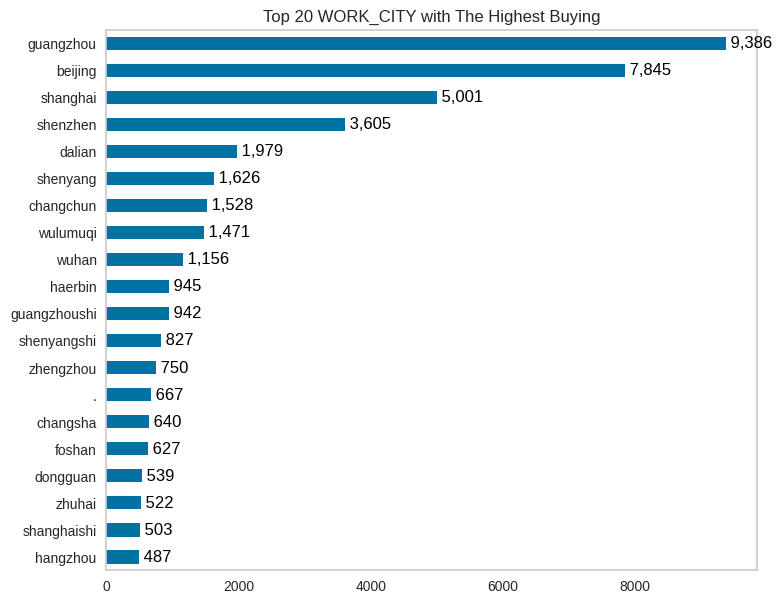

In [26]:
#Showing top 20 of WORK_CITY
plot(data, 'WORK_CITY', n=20)
plt.title("Top 20 WORK_CITY with The Highest Buying")

Text(0.5, 1.0, 'Top 20 WORK_PROVINCE with The Highest Buying')

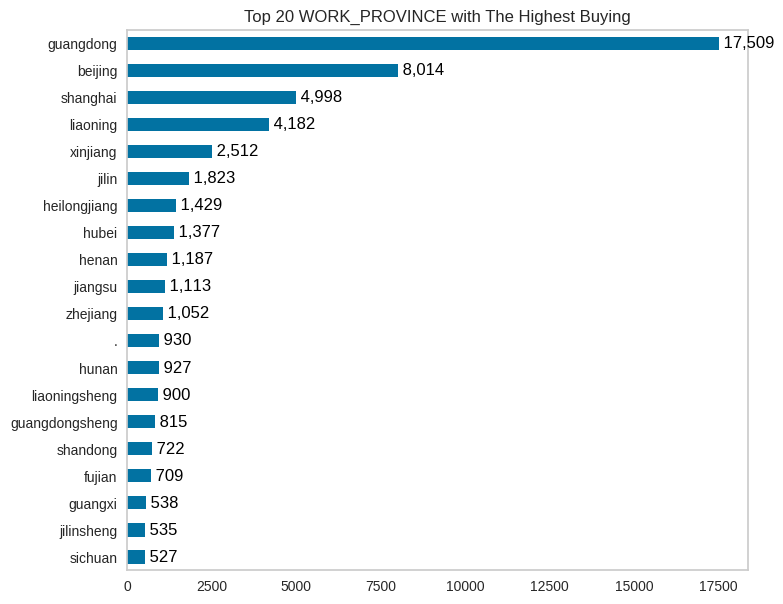

In [27]:
#Showing top 20 of WORK_PROVINCE
plot(data, 'WORK_PROVINCE', n=20)
plt.title("Top 20 WORK_PROVINCE with The Highest Buying")

Text(0.5, 1.0, 'Top 20 WORK_COUNTRY with The Highest Buying')

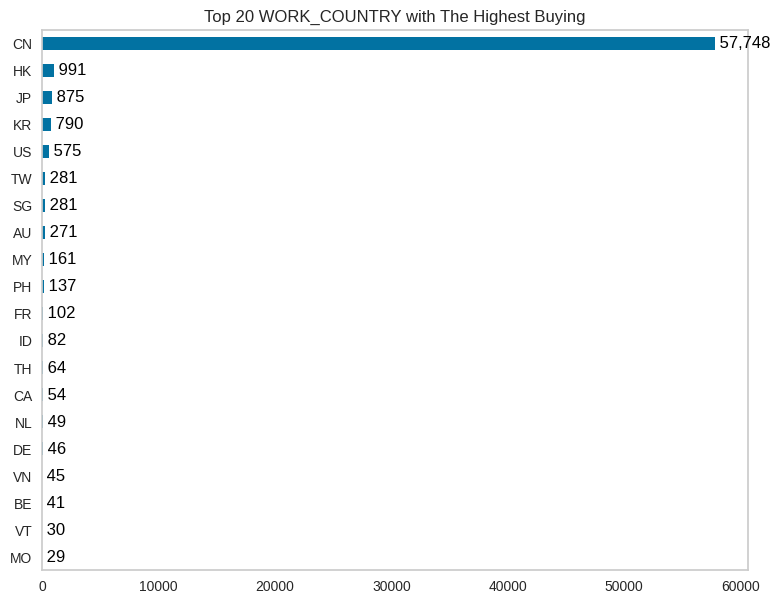

In [28]:
#Showing top 20 of WORK_COUNTRY
plot(data, 'WORK_COUNTRY', n=20)
plt.title("Top 20 WORK_COUNTRY with The Highest Buying")

Text(0.5, 1.0, 'Top 20 GENDER with The Highest Buying')

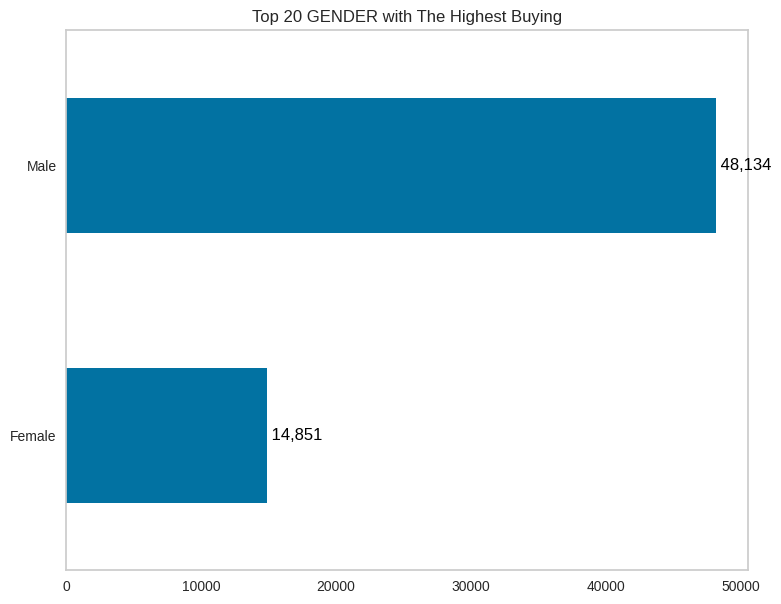

In [29]:
#Showing top 20 of GENDER
plot(data, 'GENDER', n=20)
plt.title("Top 20 GENDER with The Highest Buying")

As we can see above, because the majority of our customers work in china region, hence we want to do analysis on this major work country

In [30]:
# Correct filtering for multiple values in WORK_COUNTRY
data_china_regions = data[data['WORK_COUNTRY'].isin(['CN', 'HK', 'TW'])]
data_china_regions.sample(5)

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
43808,13862,8/23/2011,10/7/2011,Male,4,guangzhou,guangdong,CN,56.0,3/31/2014,3,3079,3062.0,0.0,5690,10/23/2012,526,53.500000,97,0,0.675571,3079,0
55763,20152,1/1/2005,2/2/2005,Male,4,guangzhoushi,guangdongsheng,CN,38.0,3/31/2014,2,1677,1856.0,0.0,2616,6/5/2012,666,2.000000,2,0,0.725000,1677,0
10703,36339,2/27/2012,4/12/2012,Male,4,beijing,beijing,CN,33.0,3/31/2014,14,15438,19056.0,0.0,27864,11/12/2012,506,16.461538,33,0,0.749582,24651,18
16504,15486,2/25/2012,2/25/2012,Male,4,guangzhou,guangdong,CN,27.0,3/31/2014,16,16180,2432.0,12138.0,18215,3/30/2014,2,41.066667,313,0,0.806686,16278,1
23189,4332,1/8/2010,1/11/2010,Male,4,guangzhou,guangdong,CN,35.0,3/31/2014,12,9627,6183.0,3722.0,14807,3/28/2014,4,61.545455,337,0,0.706391,9627,0


### Bivariate Analysis
- Analysis based on the relationship between 2 columns in the dataset, usually performing an aggregation (Sum, count, max, min, etc.)

In [31]:
data.columns

Index(['MEMBER_NO', 'FFP_DATE', 'FIRST_FLIGHT_DATE', 'GENDER', 'FFP_TIER',
       'WORK_CITY', 'WORK_PROVINCE', 'WORK_COUNTRY', 'AGE', 'LOAD_TIME',
       'FLIGHT_COUNT', 'BP_SUM', 'SUM_YR_1', 'SUM_YR_2', 'SEG_KM_SUM',
       'LAST_FLIGHT_DATE', 'LAST_TO_END', 'AVG_INTERVAL', 'MAX_INTERVAL',
       'EXCHANGE_COUNT', 'avg_discount', 'Points_Sum', 'Point_NotFlight'],
      dtype='object')

#### 1. Relationship between Flight Count and Total Points Sum
This analysis could help understand if more frequent flights correlate with a higher accumulation of loyalty points.

In [32]:
# Aggregation: Correlation
correlation_fc_ps = data[['FLIGHT_COUNT', 'Points_Sum']].corr()
correlation_fc_ps

,FLIGHT_COUNT,Points_Sum
FLIGHT_COUNT,1.000000,0.747092
Points_Sum,0.747092,1.000000


#### 2. Average Discount by FFP Tier
To see if higher tiers in the frequent flyer program (FFP) receive better average discounts.

In [33]:
# Aggregation: Mean
avg_discount_by_tier = data.groupby('FFP_TIER')['avg_discount'].mean()
avg_discount_by_tier

FFP_TIER
4    0.709052
5    0.828848
6    0.959766
Name: avg_discount, dtype: float64

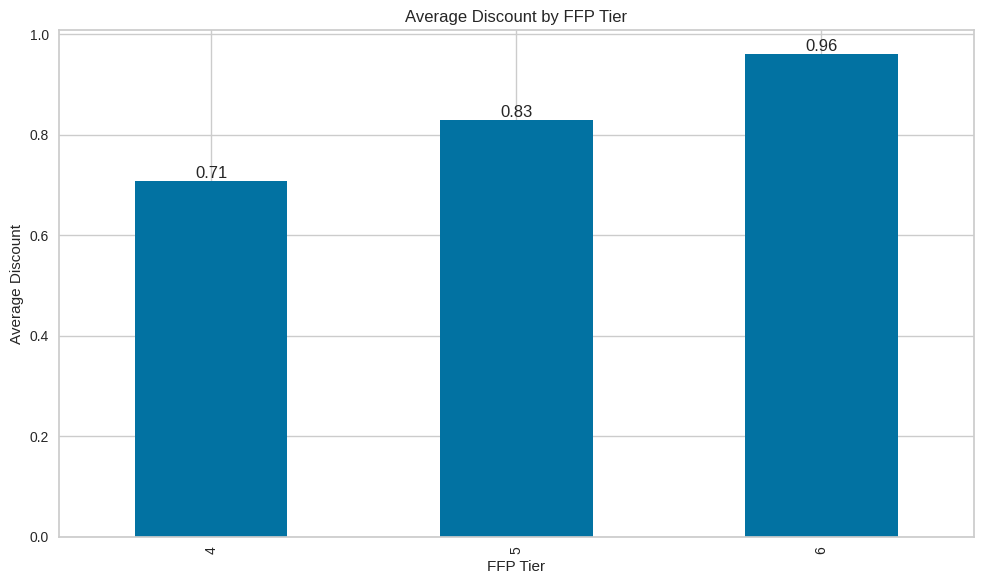

In [34]:
avg_discount_by_tier = data.groupby('FFP_TIER')['avg_discount'].mean()

# Plotting and getting the ax object
ax = avg_discount_by_tier.plot(kind='bar', figsize=(10, 6))
plt.title('Average Discount by FFP Tier')
plt.xlabel('FFP Tier')
plt.ylabel('Average Discount')

# Adding value on each bar
for i, v in enumerate(avg_discount_by_tier):
    ax.text(i, v, f'{v:.2f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()

The higher tier customer gets, the more avg discount likely to have

#### 3. Total Distance Flown by Gender
Understanding if there's a significant difference in travel patterns between genders.

In [35]:
# Aggregation: Sum
total_km_by_gender = data.groupby('GENDER')['SEG_KM_SUM'].sum()
total_km_by_gender

GENDER
Female    214659320
Male      863817725
Name: SEG_KM_SUM, dtype: int64

#### 4. Count Members by FFP Tier
This aggregates data to count unique members in each FFP tier, offering insights into the distribution of members across tiers.

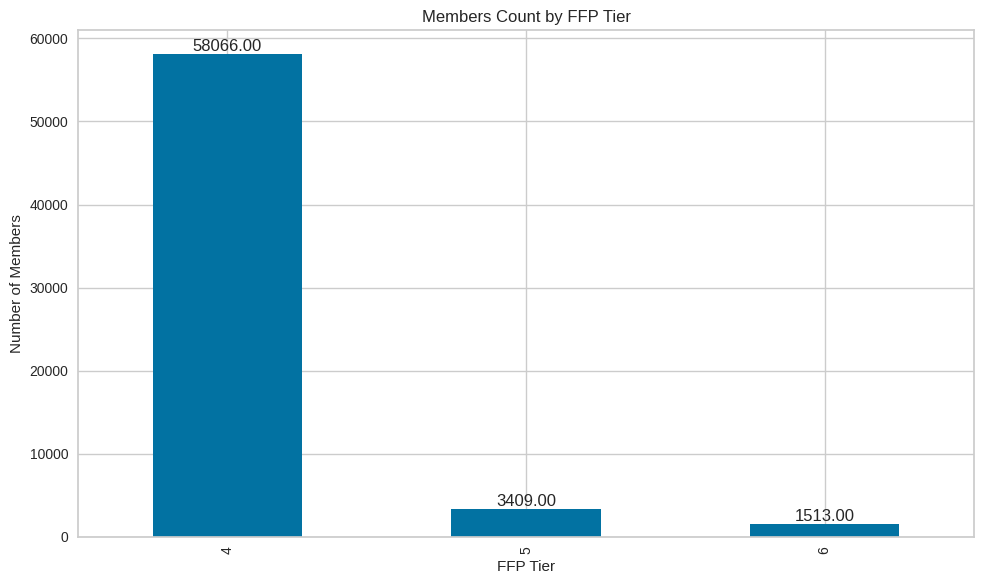

In [36]:
# Count unique MEMBER_NO in each FFP_TIER
members_by_tier = data.groupby('FFP_TIER')['MEMBER_NO'].nunique()

# Plotting
ax = members_by_tier.plot(kind='bar', figsize=(10, 6))
plt.title('Members Count by FFP Tier')
plt.xlabel('FFP Tier')
plt.ylabel('Number of Members')

# Adding value on each bar
for i, v in enumerate(members_by_tier):
    ax.text(i, v, f'{v:.2f}', ha='center', va='bottom')

plt.tight_layout()
plt.show()


#### 5. Max and Min Flight Interval by FFP Tier
Checking if higher tiers are associated with more or less frequent travel.

In [37]:
# Aggregation: Max, Min
max_interval_by_tier = data.groupby('FFP_TIER')['MAX_INTERVAL'].max()
min_interval_by_tier = data.groupby('FFP_TIER')['MAX_INTERVAL'].min()

In [38]:
max_interval_by_tier

FFP_TIER
4    728
5    714
6    683
Name: MAX_INTERVAL, dtype: int64

In [39]:
min_interval_by_tier

FFP_TIER
4    0
5    0
6    0
Name: MAX_INTERVAL, dtype: int64

#### Top 10 customers with the most Total Travel and Revenue we received for year 1 and year 2

In [40]:
#Create total_travel column
data['total_travel'] = data['FLIGHT_COUNT'] * data['SEG_KM_SUM']

# Group by 'MEMBER_NO', aggregate 'total_travel' and 'SUM_YR_1', then sort and display top 20
result = (data.groupby('MEMBER_NO')
              .agg(Total_Travel=('total_travel', 'sum'),
                   Revenue_YR_1=('SUM_YR_1', 'sum'),
                   Revenue_YR_2=('SUM_YR_2', 'sum'))
              .reset_index()
              .sort_values('Total_Travel', ascending=False)
              .head(10))
result

,MEMBER_NO,Total_Travel,Revenue_YR_1,Revenue_YR_2
54992,54993,121950570,239560.0,234188.0
49736,49737,54332600,113295.0,41200.0
39545,39546,47109056,124560.0,130702.0
12325,12326,44544843,74201.0,104344.0
28064,28065,41114920,171483.0,167434.0
20120,20121,40513016,93532.0,60040.0
45074,45075,40026321,136769.0,96568.0
37993,37994,39358510,92975.0,126821.0
55105,55106,38301120,163618.0,164982.0
62750,62751,38064298,71418.0,112597.0


- SUM_YR_1: This represents the fare revenue, which can be understood as the money made from selling flight tickets to the member in year 1.
- SUM_YR_2: This represents votes prices, which could be interpreted as the revenue from ancillary services or possibly loyalty program activities in year 2. It's a bit unclear what "votes prices" exactly means, but assuming it relates to additional revenue from the member, it can be included in the total value generated by the member.
- SEG_KM_SUM: This is the total distance traveled by the member in kilometers.

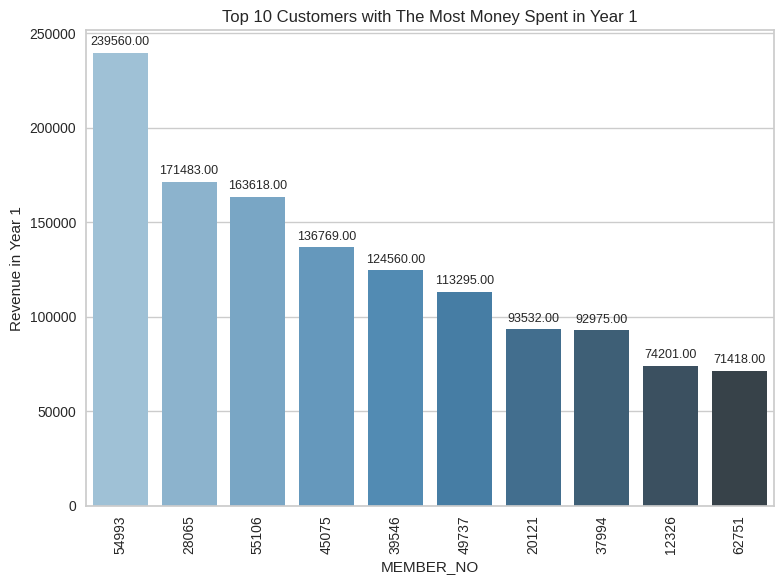

In [41]:
# Sort 'result' by 'Revenue_YR_1' in descending order
result_sorted = result.sort_values('Revenue_YR_1', ascending=False)

# Visualization
plt.figure(figsize=(8, 6))
result_sorted['MEMBER_NO'] = result_sorted['MEMBER_NO'].astype(str)
ax = sns.barplot(data=result_sorted, x='MEMBER_NO', y='Revenue_YR_1', palette="Blues_d")
plt.xticks(rotation=90)
plt.xlabel("MEMBER_NO")
plt.ylabel("Revenue in Year 1")
plt.title("Top 10 Customers with The Most Money Spent in Year 1")

# Adding value on each bar
for i, v in enumerate(result_sorted['Revenue_YR_1']):
    ax.text(i, v + (max(result_sorted['Revenue_YR_1']) * 0.01), f'{v:.2f}', ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


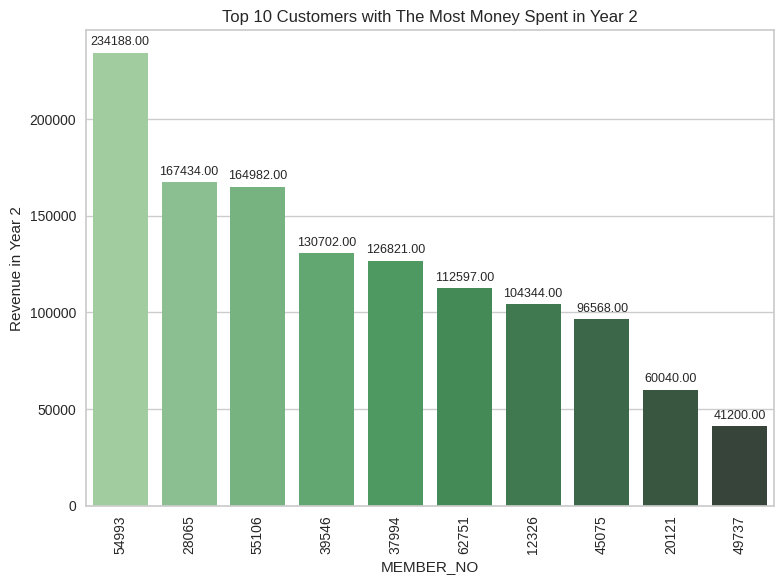

In [42]:
# Sort 'result' by 'Revenue_YR_2' in descending order
result_sorted = result.sort_values('Revenue_YR_2', ascending=False)

# Visualization
plt.figure(figsize=(8, 6))
result_sorted['MEMBER_NO'] = result_sorted['MEMBER_NO'].astype(str)
ax = sns.barplot(data=result_sorted, x='MEMBER_NO', y='Revenue_YR_2', palette="Greens_d")
plt.xticks(rotation=90)
plt.xlabel("MEMBER_NO")
plt.ylabel("Revenue in Year 2")
plt.title("Top 10 Customers with The Most Money Spent in Year 2")

# Adding value on each bar
for i, v in enumerate(result_sorted['Revenue_YR_2']):
    ax.text(i, v + (max(result_sorted['Revenue_YR_2']) * 0.01), f'{v:.2f}', ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


In [43]:
data = data.drop('total_travel', axis=1)

#### FFP_Date and First_Flight_Date over the years

Text(0.5, 0, 'FIRST FLIGHT DATE YEAR')

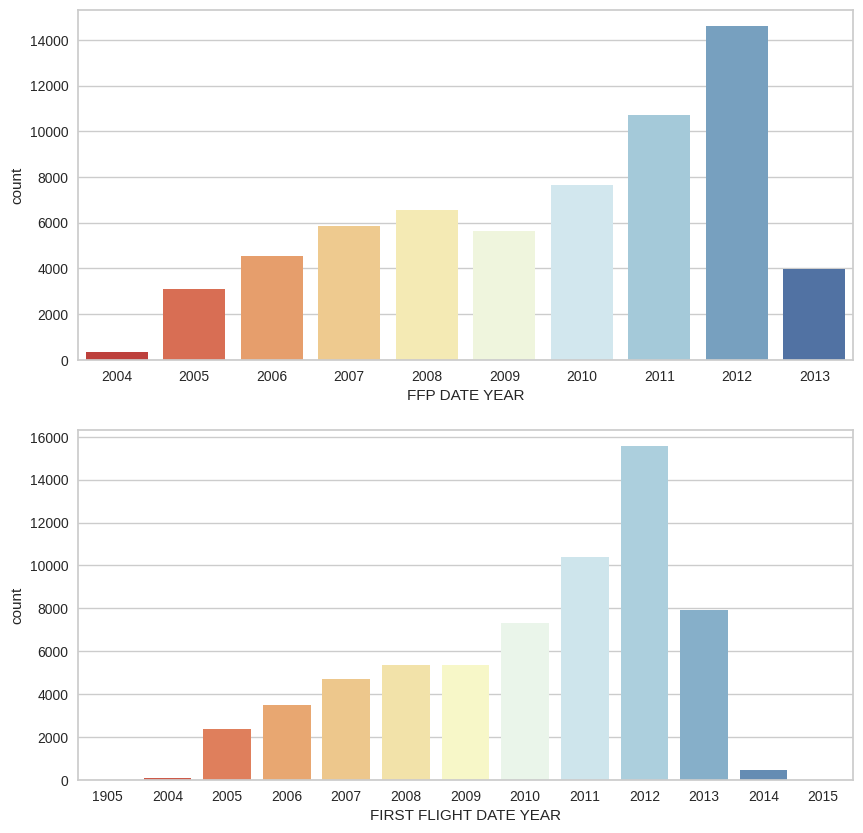

In [44]:
# create a graph in 2 rows with 1 column format
fig, ax = plt.subplots(nrows=2,ncols=1,figsize=(10,10))

# FFP
# change the object type to datetime
FFP = pd.to_datetime(data['FFP_DATE']).dt.year
# visualize
sns.countplot(x=FFP,ax=ax[0], palette=('RdYlBu'))
ax[0].tick_params(axis='x')
ax[0].set_xlabel('FFP DATE YEAR')

# FFD
# change the object type to datetime
FFD = pd.to_datetime(data['FIRST_FLIGHT_DATE']).dt.year
# visualize
sns.countplot(x=FFD, ax=ax[1], palette=('RdYlBu'))
ax[1].tick_params(axis='x')
ax[1].set_xlabel('FIRST FLIGHT DATE YEAR')

In the LAST_FLIGHT_DATE feature, we found value 2014/2/29 which doesn't make sense because 2014 is not a leap year.

## Assignment 3 : Perform Feature Engineering
1. Drop duplicates
2. Check for missing values
3. Change the data type if it doesn't match, for example it should be datetime but object, then change object to datetime.
4. Perform StandardScaller for feature scaling
5. Handling outliers, and other feature engineering techniques if necessary
* unsupervised, no need data to be splitting


In [45]:
data.shape

(62988, 23)

In [46]:
data.describe()

,MEMBER_NO,FFP_TIER,AGE,FLIGHT_COUNT,BP_SUM,SUM_YR_1,SUM_YR_2,SEG_KM_SUM,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
count,62988.000000,62988.000000,62568.000000,62988.000000,62988.000000,62437.000000,62850.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.000000,62988.0000,62988.000000
mean,31494.500000,4.102162,42.476346,11.839414,10925.081254,5355.376064,5604.026014,17123.878691,176.120102,67.749788,166.033895,0.319775,0.721558,12545.7771,2.728155
std,18183.213715,0.373856,9.885915,14.049471,16339.486151,8109.450147,8703.364247,20960.844623,183.822223,77.517866,123.397180,1.136004,0.185427,20507.8167,7.364164
min,1.000000,4.000000,6.000000,2.000000,0.000000,0.000000,0.000000,368.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000
25%,15747.750000,4.000000,35.000000,3.000000,2518.000000,1003.000000,780.000000,4747.000000,29.000000,23.370370,79.000000,0.000000,0.611997,2775.0000,0.000000
50%,31494.500000,4.000000,41.000000,7.000000,5700.000000,2800.000000,2773.000000,9994.000000,108.000000,44.666667,143.000000,0.000000,0.711856,6328.5000,0.000000
75%,47241.250000,4.000000,48.000000,15.000000,12831.000000,6574.000000,6845.750000,21271.250000,268.000000,82.000000,228.000000,0.000000,0.809476,14302.5000,1.000000
max,62988.000000,6.000000,110.000000,213.000000,505308.000000,239560.000000,234188.000000,580717.000000,731.000000,728.000000,728.000000,46.000000,1.500000,985572.0000,140.000000


#### 1. Drop Duplicated

In [47]:
# Check duplicate
duplicates_all = data[data.duplicated(keep=False)]
print(f"Total exact duplicate entries in dataframe: {duplicates_all.shape[0]}")

Total exact duplicate entries in dataframe: 0


In [48]:
data = data.drop_duplicates(keep='first')
data.shape

(62988, 23)

#### 2. Missing Values Handling

##### Check Missing Values

In [49]:
data.isna().sum()

MEMBER_NO               0
FFP_DATE                0
FIRST_FLIGHT_DATE       0
GENDER                  3
FFP_TIER                0
WORK_CITY            2269
WORK_PROVINCE        3248
WORK_COUNTRY           26
AGE                   420
LOAD_TIME               0
FLIGHT_COUNT            0
BP_SUM                  0
SUM_YR_1              551
SUM_YR_2              138
SEG_KM_SUM              0
LAST_FLIGHT_DATE        0
LAST_TO_END             0
AVG_INTERVAL            0
MAX_INTERVAL            0
EXCHANGE_COUNT          0
avg_discount            0
Points_Sum              0
Point_NotFlight         0
dtype: int64

In [50]:
data.isnull().sum()

MEMBER_NO               0
FFP_DATE                0
FIRST_FLIGHT_DATE       0
GENDER                  3
FFP_TIER                0
WORK_CITY            2269
WORK_PROVINCE        3248
WORK_COUNTRY           26
AGE                   420
LOAD_TIME               0
FLIGHT_COUNT            0
BP_SUM                  0
SUM_YR_1              551
SUM_YR_2              138
SEG_KM_SUM              0
LAST_FLIGHT_DATE        0
LAST_TO_END             0
AVG_INTERVAL            0
MAX_INTERVAL            0
EXCHANGE_COUNT          0
avg_discount            0
Points_Sum              0
Point_NotFlight         0
dtype: int64

##### Missing values check Nan

In [51]:
data.isnull().sum().sum()

6655

In [52]:
data.isnull().any().any()

True

In [53]:
count_nan = data.isnull().sum()
print ('Count of NaN: ' + str(count_nan))

Count of NaN: MEMBER_NO               0
FFP_DATE                0
FIRST_FLIGHT_DATE       0
GENDER                  3
FFP_TIER                0
WORK_CITY            2269
WORK_PROVINCE        3248
WORK_COUNTRY           26
AGE                   420
LOAD_TIME               0
FLIGHT_COUNT            0
BP_SUM                  0
SUM_YR_1              551
SUM_YR_2              138
SEG_KM_SUM              0
LAST_FLIGHT_DATE        0
LAST_TO_END             0
AVG_INTERVAL            0
MAX_INTERVAL            0
EXCHANGE_COUNT          0
avg_discount            0
Points_Sum              0
Point_NotFlight         0
dtype: int64


In [54]:
for column in data.columns[1:]:
    print(f"============= {column} =================")
    display(data[column].value_counts())
    print()

============= FFP_DATE =================


1/13/2011     184
1/1/2013      165
3/1/2013      100
11/17/2010     99
1/14/2011      95
9/19/2012      88
3/15/2012      86
9/9/2005       85
10/16/2012     84
1/15/2011      83
11/29/2010     81
12/13/2010     81
8/14/2012      80
5/1/2012       80
1/4/2011       79
9/11/2012      77
7/10/2012      76
11/2/2012      76
11/25/2010     76
12/26/2012     76
8/1/2011       73
7/21/2012      73
12/20/2010     73
10/23/2012     72
7/25/2012      71
10/30/2012     69
4/12/2012      69
7/5/2012       69
11/20/2012     68
9/14/2011      68
1/24/2011      67
11/1/2007      66
3/1/2012       65
8/1/2012       65
7/1/2012       65
4/30/2012      65
8/7/2012       63
7/9/2011       63
4/6/2012       63
11/19/2010     62
1/23/2013      62
2/27/2013      62
11/6/2012      62
3/23/2013      62
5/23/2012      62
3/19/2013      62
6/26/2012      61
8/23/2012      61
2/27/2012      61
1/1/2012       61
9/1/2012       61
6/13/2012      61
1/24/2013      61
5/29/2012      60
2/1/2011       60
2/28/2013 


============= FIRST_FLIGHT_DATE =================


2/16/2013     96
9/30/2012     85
2/15/2013     84
9/9/2005      78
4/21/2012     70
4/27/2012     70
7/5/2012      69
2/28/2013     69
4/30/2012     69
9/20/2012     68
5/26/2012     68
4/23/2012     67
4/6/2012      66
9/28/2012     66
4/26/2012     65
7/10/2012     64
2/6/2013      64
9/21/2012     63
7/14/2012     63
4/29/2012     63
2/10/2013     63
5/16/2012     62
2/11/2013     62
3/23/2013     62
3/19/2013     61
9/16/2012     61
1/15/2013     60
4/9/2012      60
7/24/2012     60
2/5/2013      60
3/18/2013     59
7/19/2012     59
8/9/2012      59
5/19/2012     58
9/5/2012      58
3/27/2013     58
4/28/2012     58
1/26/2013     58
10/31/2012    58
10/23/2012    58
11/9/2012     57
7/25/2012     57
1/17/2013     57
4/12/2012     57
8/10/2012     57
2/27/2013     57
8/19/2012     57
1/10/2013     57
8/17/2012     57
7/7/2012      57
8/15/2012     56
8/26/2012     56
1/31/2013     56
10/9/2012     56
11/5/2012     56
8/7/2012      56
7/20/2012     56
9/29/2012     56
2/14/2013     


============= GENDER =================


Male      48134
Female    14851
Name: GENDER, dtype: int64


============= FFP_TIER =================


4    58066
5     3409
6     1513
Name: FFP_TIER, dtype: int64


============= WORK_CITY =================


guangzhou                      9386
beijing                        7845
shanghai                       5001
shenzhen                       3605
dalian                         1979
shenyang                       1626
changchun                      1528
wulumuqi                       1471
wuhan                          1156
haerbin                         945
guangzhoushi                    942
shenyangshi                     827
zhengzhou                       750
.                               667
changsha                        640
foshan                          627
dongguan                        539
zhuhai                          522
shanghaishi                     503
hangzhou                        487
nanjing                         478
shantou                         441
guiyang                         429
changchunshi                    414
chengdu                         402
wulumuqishi                     380
shamen                          370
qingdao                     


============= WORK_PROVINCE =================


guangdong                        17509
beijing                           8014
shanghai                          4998
liaoning                          4182
xinjiang                          2512
jilin                             1823
heilongjiang                      1429
hubei                             1377
henan                             1187
jiangsu                           1113
zhejiang                          1052
.                                  930
hunan                              927
liaoningsheng                      900
guangdongsheng                     815
shandong                           722
fujian                             709
guangxi                            538
jilinsheng                         535
sichuan                            527
guizhou                            481
shanxi                             438
hainan                             315
Seoul                              293
tianjin                            292
-                        


============= WORK_COUNTRY =================


CN    57748
HK      991
JP      875
KR      790
US      575
TW      281
SG      281
AU      271
MY      161
PH      137
FR      102
ID       82
TH       64
CA       54
NL       49
DE       46
VN       45
BE       41
VT       30
MO       29
IT       22
UK       21
PK       20
IN       16
KH       14
AN       12
中        11
AE       11
CH       10
ES        7
MA        6
IL        6
SE        5
AA        5
GB        5
NZ        5
AT        5
MX        5
NG        5
NI        4
ZA        4
IR        4
HU        3
AR        3
UZ        3
DK        3
KA        3
GE        3
AZ        2
EG        2
HN        2
BR        2
SN        2
LB        2
UA        2
SI        2
CY        2
UY        2
BD        2
TR        2
LA        2
MV        2
SA        2
KZ        2
NE        2
FI        2
PT        2
GN        1
北         1
SU        1
RU        1
沈         1
GU        1
CC        1
ZW        1
PP        1
芬         1
FO        1
IE        1
BS        1
PR        1
PN        1
GH        1
SK  


============= AGE =================


47.0     2727
38.0     2713
37.0     2683
42.0     2622
39.0     2595
40.0     2549
41.0     2464
36.0     2335
46.0     2323
35.0     2265
48.0     2245
34.0     2218
32.0     2107
45.0     2105
33.0     2105
31.0     1941
44.0     1923
43.0     1839
30.0     1633
29.0     1391
50.0     1296
49.0     1246
53.0     1237
54.0     1179
52.0     1159
28.0     1144
55.0     1085
56.0     1069
51.0     1012
57.0      823
58.0      707
27.0      648
59.0      581
60.0      557
61.0      441
62.0      358
63.0      331
26.0      306
64.0      273
65.0      239
25.0      209
66.0      208
24.0      193
67.0      154
68.0      148
69.0      137
70.0      128
23.0      126
71.0      103
72.0       89
73.0       78
22.0       70
74.0       63
76.0       56
75.0       42
77.0       37
21.0       31
20.0       30
78.0       27
17.0       23
19.0       22
18.0       19
79.0       17
16.0       11
82.0       10
80.0       10
81.0        8
83.0        6
84.0        5
13.0        5
15.0        4
86.0  


============= LOAD_TIME =================


3/31/2014    62988
Name: LOAD_TIME, dtype: int64


============= FLIGHT_COUNT =================


2      10394
3       6477
4       5494
5       4321
6       3676
7       3072
8       2800
9       2298
10      2145
11      1854
12      1703
13      1522
14      1389
15      1180
16      1109
17      1008
18       888
19       817
20       744
21       682
22       638
23       596
24       578
25       489
26       446
28       412
27       404
29       364
30       327
31       313
32       278
33       266
35       229
34       222
36       211
37       204
39       192
38       191
40       183
42       142
45       142
41       141
43       129
44       125
46       121
47       108
49       100
48        96
50        95
51        89
53        81
52        78
54        69
56        61
55        61
57        57
62        54
63        52
61        51
59        51
58        51
67        47
60        47
65        44
64        41
69        40
66        36
68        36
72        28
71        27
78        25
73        25
75        24
70        23
82        23
77        22
81        21


============= BP_SUM =================


0         565
1000      257
700       120
1526      120
2671      105
400       104
1220       83
763        76
500        76
1677       74
1292       72
1572       71
968        67
1908       65
2396       62
2753       61
9304       60
1500       60
958        60
200        59
1596       59
3816       55
3934       55
786        51
1656       50
3449       48
1695       48
2000       47
2658       46
2422       45
1970       45
1198       44
1200       43
1447       42
479        42
1670       41
692        40
4122       39
5998       39
854        39
954        38
5086       36
1452       35
484        35
868        34
2910       34
2100       34
1185       33
422        33
2386       33
1212       33
2484       32
2726       32
1630       32
1521       32
488        31
1830       31
844        31
2174       31
2068       31
1700       30
1648       30
1748       30
2228       29
2072       29
672        29
1120       29
1400       29
1087       28
1841       28
610        28
1234  


============= SUM_YR_1 =================


0.00         9915
960.00        174
690.00        151
700.00        143
1024.00       136
1400.00       135
1280.00       126
1190.00       117
710.00        116
1360.00       109
1050.00       105
1920.00       105
1700.00       101
1380.00        93
630.00         91
660.00         82
800.00         79
2100.00        76
1260.00        74
1420.00        72
2380.00        70
680.00         68
1750.00        67
640.00         66
840.00         66
730.00         65
2210.00        64
2040.00        63
768.00         63
1152.00        63
1890.00        62
560.00         62
1680.00        61
1225.00        60
1200.00        60
1320.00        59
864.00         58
1210.00        58
2130.00        57
2410.00        57
1440.00        56
2550.00        56
1020.00        56
672.00         54
2400.00        53
1040.00        53
2800.00        50
2625.00        50
890.00         49
2080.00        49
850.00         48
1728.00        48
2310.00        48
1600.00        48
3200.00        46
2560.00   


============= SUM_YR_2 =================


0.0         11812
883.0          76
644.0          66
986.0          62
1000.0         60
1309.0         59
635.0          58
672.0          56
476.0          56
690.0          53
1200.0         53
1348.0         51
1564.0         48
653.0          47
1400.0         47
2000.0         46
1190.0         41
1178.0         40
1330.0         40
864.0          39
1288.0         39
938.0          39
630.0          38
960.0          38
600.0          37
686.0          37
1113.0         37
1260.0         37
578.0          37
2400.0         36
595.0          36
800.0          35
1300.0         35
3100.0         35
1900.0         35
2100.0         34
607.0          34
840.0          34
1139.0         33
3000.0         33
435.0          33
1766.0         33
4600.0         33
742.0          33
1610.0         33
1600.0         33
660.0          32
700.0          32
2200.0         32
710.0          32
900.0          32
2300.0         32
768.0          32
4400.0         31
1334.0         31
1050.0    


============= SEG_KM_SUM =================


3934      298
4154      181
2616      179
1298      145
1158      117
24464     100
2710       99
5684       91
2748       89
5420       87
2085       81
1866       76
2020       75
5901       70
1746       69
4268       67
1380       66
2750       66
4644       65
2892       63
2780       58
7672       56
1522       55
3385       54
7868       53
1947       52
6231       51
1160       48
3924       47
4196       47
5344       46
1494       45
2254       42
2994       41
2158       41
1622       40
2799       40
36696      40
4570       39
1312       37
5342       37
1774       37
3451       36
1737       36
6460       35
1096       35
2572       35
6238       34
4065       34
2682       33
5232       33
2800       33
1332       32
1074       32
5286       32
3030       32
2253       31
1134       31
3904       31
48928      31
1744       31
5242       30
4078       30
8308       30
3275       30
2390       30
760        29
16254      29
3560       29
2229       29
4986       28
9835  


============= LAST_FLIGHT_DATE =================


3/31/2014             959
3/30/2014             933
3/28/2014             924
3/29/2014             779
3/27/2014             767
3/26/2014             728
3/21/2014             678
3/20/2014             658
3/24/2014             601
3/23/2014             599
3/25/2014             597
3/19/2014             586
3/18/2014             526
3/22/2014             496
3/14/2014             489
3/12/2014             464
3/16/2014             461
3/17/2014             425
3/11/2014             425
3/15/2014             422
3/7/2014              421
2014/2/29  0:00:00    421
3/9/2014              407
2/27/2014             399
3/13/2014             396
3/5/2014              375
3/10/2014             367
3/2/2014              357
2/17/2014             354
3/6/2014              347
3/8/2014              345
2/28/2014             343
3/1/2014              333
2/12/2014             326
2/24/2014             322
2/26/2014             320
2/22/2014             296
3/3/2014              296
3/4/2014    


============= LAST_TO_END =================


1      959
2      933
4      924
3      779
5      767
6      728
11     678
12     658
8      601
9      599
7      597
13     586
14     526
10     496
18     489
20     464
16     461
15     425
21     425
17     422
25     421
32     421
23     407
34     399
19     396
27     375
22     367
30     357
44     354
26     347
24     345
33     343
31     333
49     326
37     322
35     320
39     296
29     296
28     287
36     281
43     277
38     266
48     257
67     254
45     243
74     236
69     236
40     234
42     229
47     228
68     226
76     222
65     219
66     218
75     218
72     213
61     212
46     212
70     212
73     210
102    206
50     206
77     197
60     195
71     193
79     193
109    191
41     190
81     190
62     189
80     188
57     188
58     186
112    181
103    181
104    178
78     175
95     174
94     173
56     173
83     173
107    170
82     169
86     168
84     166
137    163
116    163
101    160
64     160
100    159
123    159


============= AVG_INTERVAL =================


2.000000      872
3.000000      800
4.000000      622
1.000000      601
5.000000      440
0.000000      421
7.000000      320
6.000000      317
8.000000      226
9.000000      194
10.000000     177
12.000000     153
14.000000     146
11.000000     138
30.000000     128
31.000000     127
21.000000     127
23.000000     125
28.000000     124
44.000000     124
37.000000     123
17.000000     123
34.000000     123
33.000000     122
49.000000     121
43.000000     121
35.000000     121
63.000000     121
16.000000     120
13.000000     120
41.000000     118
19.000000     116
45.000000     114
15.000000     113
29.000000     113
26.000000     112
50.000000     111
36.000000     111
20.000000     110
47.000000     110
42.000000     109
39.000000     109
48.000000     108
18.000000     108
22.000000     107
25.000000     105
54.000000     105
55.000000     105
38.000000     104
40.000000     104
65.000000     104
46.000000     103
24.000000     103
57.000000     102
73.000000     101
61.000000 


============= MAX_INTERVAL =================


2      880
3      852
4      681
1      569
5      468
0      421
6      359
7      351
126    294
147    282
91     274
133    273
121    269
120    267
98     267
88     266
83     265
116    264
119    263
143    263
111    262
92     261
139    261
112    261
102    261
131    260
86     259
99     259
138    257
105    257
96     256
135    256
117    255
153    254
118    253
115    252
123    251
109    251
122    251
137    251
94     251
124    250
146    250
134    250
129    250
89     249
93     249
132    248
101    248
80     247
154    247
140    247
106    246
114    241
113    240
97     240
104    240
103    239
110    238
8      237
125    235
128    235
145    233
81     232
107    232
130    230
136    230
108    229
158    227
182    226
148    226
151    226
66     225
95     225
181    225
82     224
84     224
161    224
70     224
150    223
156    222
187    222
175    221
9      221
85     220
173    220
183    220
67     220
100    219
159    219
77     217


============= EXCHANGE_COUNT =================


0     54254
1      3969
2      2272
3      1066
4       591
5       309
6       186
7       106
8        71
9        38
10       36
11       18
12       14
14       11
13       11
15        9
17        5
20        4
18        4
16        3
27        3
22        2
21        1
46        1
34        1
19        1
29        1
37        1
Name: EXCHANGE_COUNT, dtype: int64


============= avg_discount =================


1.000000    757
0.400000    413
0.800000    391
0.750000    370
0.700000    311
0.850000    225
0.550000    224
0.900000    199
0.650000    197
0.600000    191
0.920000    172
0.500000    148
0.625000    147
0.450000    146
0.250000    133
1.500000    116
0.725000    108
0.575000    108
0.775000     93
0.475000     86
0.675000     86
0.825000     82
0.875000     77
0.525000     77
0.950000     75
0.580000     74
0.770000     72
1.410000     70
0.340000     66
0.380000     66
0.670000     65
0.720000     59
0.350000     57
0.490000     56
0.760000     47
0.425000     46
0.835000     42
0.375000     42
0.925000     40
0.300000     40
0.280000     38
0.845000     38
0.640000     38
0.710000     37
0.660000     35
0.630000     35
1.050000     34
0.733333     32
0.730000     32
0.820000     32
0.960000     31
0.690000     31
0.785000     30
0.735000     29
1.030000     29
0.810000     29
0.740000     29
0.933333     28
0.910000     27
0.330000     27
0.780000     26
0.716667     26
0.560000


============= Points_Sum =================


0         423
1000      222
700        98
1526       88
400        87
2671       75
1220       73
500        63
763        60
1596       59
9304       58
968        58
1292       58
1572       57
1908       54
2396       53
1500       52
1677       52
3934       51
2753       49
2000       46
1695       45
200        44
3816       44
2422       43
786        43
958        43
1200       43
1656       42
3449       42
1970       40
1670       37
4122       37
1198       37
1447       37
5998       37
954        36
854        35
5086       34
692        33
2386       33
2658       32
2100       31
484        31
479        31
1185       30
2910       30
1452       30
2174       29
2726       29
2068       29
2072       29
1700       29
488        28
2484       28
1830       27
1521       27
1212       27
920        26
2228       26
422        26
1992       26
868        26
1630       26
1400       26
1967       25
1234       25
1120       25
2034       24
1270       24
1938       24
1648  


============= Point_NotFlight =================


0      42480
1       6381
2       2838
3       1661
4       1091
5        721
6        580
7        459
8        402
9        395
10       366
11       338
12       331
13       324
14       258
16       255
15       249
17       238
20       235
23       222
26       220
25       217
19       215
28       214
29       212
24       203
27       198
18       197
21       195
22       189
30       164
31       124
32       109
33        95
34        67
35        62
36        49
39        40
40        38
37        38
41        28
38        24
43        23
42        21
45        15
50        15
47        15
49        15
48        14
44        14
46        13
52         8
55         7
57         7
51         7
53         5
64         5
77         5
58         5
60         5
66         5
81         4
68         4
59         3
65         3
61         3
82         3
92         3
88         2
69         2
75         2
54         2
62         2
90         2
63         2
56         2
70         1

##### Check percentage of missing value in each column selection

In [55]:
#check percentage missing value
percent_missing = data.isnull().sum() * 100 / len(data)
missing_value_df = pd.DataFrame({'column_name': data.columns,
                                 'percent_missing': percent_missing})
missing_value_df

,column_name,percent_missing
MEMBER_NO,MEMBER_NO,0.000000
FFP_DATE,FFP_DATE,0.000000
FIRST_FLIGHT_DATE,FIRST_FLIGHT_DATE,0.000000
GENDER,GENDER,0.004763
FFP_TIER,FFP_TIER,0.000000
WORK_CITY,WORK_CITY,3.602273
WORK_PROVINCE,WORK_PROVINCE,5.156538
WORK_COUNTRY,WORK_COUNTRY,0.041278
AGE,AGE,0.666794
LOAD_TIME,LOAD_TIME,0.000000


From the result code above, we saw that there are also missing value in several columns. Below is the list of all missing value for each column :
- gender : NaN
- work_city : NaN/0/1/N/Regex(., ', *, /, \, ?, =, --,12961, **, MONTTK?? PARK, or 。)
- work_province : NaN/0/1/N/C/P/S/Regex(., -, ', . . , -, /, \, *, --, tai?, -, ao?, =, 0401 MM P.O.BOX 789, 33, =, ---, MONTTK?? PARK, 96081184, 7/12/1964, W, or 。)
- work_country : NaN/Regex(北, 沈, 芬)
- age : NaN
- sum_yr_1 : NaN
- sum_yr_2 : NaN
- Last_Flight_Date: 2014/2/29 is found which doesn't make sense because 2014 is not a leap year.

**If it contained a lot of missing value (let say >35%), then we can just drop that column**. If not, then we can do some imputation.

###### Imputation data for : Gender

In [56]:
# Calculate the mode for the 'gender' column
mode_gender_data = data['GENDER'].mode()[0]

# Replace NaN values with the mode
data['GENDER'] = data['GENDER'].fillna(mode_gender_data)

# Verify the operation
print(data['GENDER'].isnull().sum())  # If if all NaNs are filled, it should be 0

0


###### Imputation data for : WORK_CITY

In [57]:
# Calculate the mode for the 'WORK_CITY' column
mode_work_city_data = data['WORK_CITY'].mode()[0]

# Replace NaN values with the mode
data['WORK_CITY'] = data['WORK_CITY'].fillna(mode_work_city_data)

# Define a regex pattern to match the specified values and patterns
regex_pattern = r'^(\s*NaN\s*|0|1|N|^$|\.|,|\*|\/|\\|\?|=|--|12961|\*\*|MONTTK\?\? PARK|。)$'

# Replace values matching the regex pattern with the mode
data['WORK_CITY'] = data['WORK_CITY'].replace(regex_pattern, mode_work_city_data, regex=True)

# Verify the operation
print(data['WORK_CITY'].isnull().sum())  # If all NaNs and specified patterns are replaced, it should be 0


0


###### Imputation data for : WORK_PROVINCE

In [58]:
# Calculate the mode for the 'WORK_PROVINCE' column
mode_work_province_data = data['WORK_PROVINCE'].mode()[0]

# Replace NaN values with the mode
data['WORK_PROVINCE'] = data['WORK_PROVINCE'].fillna(mode_work_province_data)

# Define a regex pattern to match the specified values and patterns for 'WORK_PROVINCE'
regex_pattern = r'^(\s*NaN\s*|0|1|N|C|P|S|^$|\.|-|,|\. \.|\/|\\|\*|--|tai\?|ao\?|=|0401 MM P.O.BOX 789|33|---|MONTTK\?\? PARK|96081184|7/12/1964|W|。)$'

# Replace values matching the regex pattern with the mode
data['WORK_PROVINCE'] = data['WORK_PROVINCE'].replace(regex_pattern, mode_work_province_data, regex=True)

# Verify the operation
print(data['WORK_PROVINCE'].isnull().sum())  # If all NaNs and specified patterns are replaced, it should be 0


0


###### Imputation data for : WORK_COUNTRY

In [59]:
# Calculate the mode for the 'WORK_COUNTRY' column
mode_work_country_data = data['WORK_COUNTRY'].mode()[0]

# Replace NaN values with the mode
data['WORK_COUNTRY'] = data['WORK_COUNTRY'].fillna(mode_work_country_data)

# Define a regex pattern to match the specified values and patterns for 'WORK_COUNTRY'
regex_pattern = r'^(\s*NaN\s*|0|1|N|北|沈|芬)$'

# Replace values matching the regex pattern with the mode
data['WORK_COUNTRY'] = data['WORK_COUNTRY'].replace(regex_pattern, mode_work_country_data, regex=True)

# Verify the operation
print(data['WORK_COUNTRY'].isnull().sum())  # If all NaNs and specified patterns are replaced, it should be 0


0


###### Imputation data for : AGE

In [60]:
# Calculate the median of 'AGE', excluding NaN values
median_age = data['AGE'].median()

# Impute NaN values in 'AGE' with the median
data['AGE'] = data['AGE'].fillna(median_age)

# Verify the operation
print(data['AGE'].isnull().sum())  # If all NaNs are filled, it should be 0

0


###### Imputation data for : sum_yr_1

In [61]:
# Calculate the median of 'SUM_YR_1', excluding NaN values
median_sum_yr_1 = data['SUM_YR_1'].median()

# Impute NaN values in 'SUM_YR_1' with the median
data['SUM_YR_1'] = data['SUM_YR_1'].fillna(median_sum_yr_1)

# Verify the operation
print(data['SUM_YR_1'].isnull().sum())  # If all NaNs are filled, it should be 0

0


###### Imputation data for : sum_yr_2

In [62]:
# Calculate the median of 'SUM_YR_2', excluding NaN values
median_sum_yr_2 = data['SUM_YR_2'].median()

# Impute NaN values in 'SUM_YR_1' with the median
data['SUM_YR_2'] = data['SUM_YR_2'].fillna(median_sum_yr_2)

# Verify the operation
print(data['SUM_YR_2'].isnull().sum())  # If all NaNs are filled, it should be 0

0


###### Addition
We will clean data according to standard procedures for aviation datasets (Tao, 2020)

Here recorded entries whereby:
* The ticket price (SUM_YR_1, SUM_YR_2) = 0
* The average discount (avg_discount) != 0
* and The total mileage (SEG_KM_SUM) > 0

We can assume that the user has no travel history

In [63]:
# drop column
data.drop(data[(data['SUM_YR_1'] == 0) & (data['SUM_YR_2'] == 0) & (data['avg_discount'] == 0) & (data['SEG_KM_SUM'] > 0)].index, inplace = True)

###### Drop missing values in last_flight_date

In [64]:
dt_cols.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62988 entries, 0 to 62987
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   FFP_DATE           62988 non-null  datetime64[ns]
 1   FIRST_FLIGHT_DATE  62988 non-null  datetime64[ns]
 2   LOAD_TIME          62988 non-null  datetime64[ns]
 3   LAST_FLIGHT_DATE   62567 non-null  datetime64[ns]
dtypes: datetime64[ns](4)
memory usage: 1.9 MB


In [65]:
# copy dataset for temporary analysis
data_last = data.copy()

# drop data which value is 2014/2/29
data_last.drop(data_last[data_last.LAST_FLIGHT_DATE.str.contains('2014/2/29')].index, inplace = True)


Text(0.5, 0, 'LAST FLIGHT DATE YEAR')

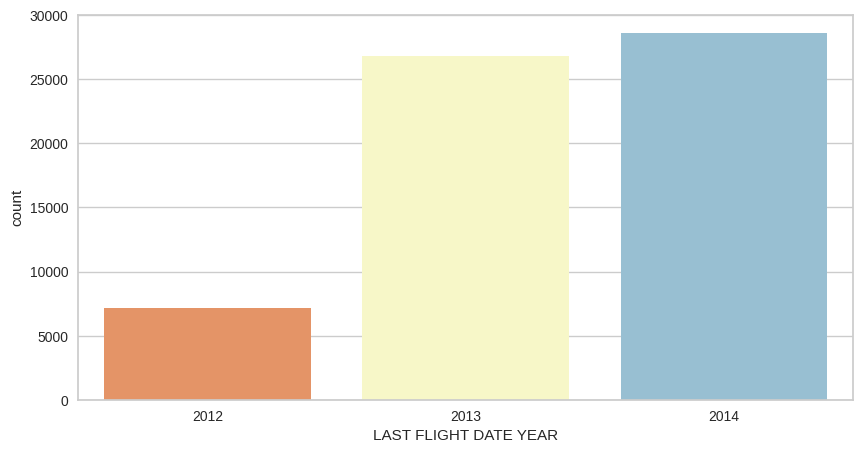

In [66]:
# visualize
fig, ax = plt.subplots(nrows=1,ncols=1,figsize=(10,5))
# change object type to datetime
LFD = pd.to_datetime(data_last['LAST_FLIGHT_DATE']).dt.year
# visualisasi
sns.countplot(x=LFD, palette='RdYlBu')
ax.set_xlabel('LAST FLIGHT DATE YEAR')

In [67]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62981 entries, 0 to 62987
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          62981 non-null  int64  
 1   FFP_DATE           62981 non-null  object 
 2   FIRST_FLIGHT_DATE  62981 non-null  object 
 3   GENDER             62981 non-null  object 
 4   FFP_TIER           62981 non-null  int64  
 5   WORK_CITY          62981 non-null  object 
 6   WORK_PROVINCE      62981 non-null  object 
 7   WORK_COUNTRY       62981 non-null  object 
 8   AGE                62981 non-null  float64
 9   LOAD_TIME          62981 non-null  object 
 10  FLIGHT_COUNT       62981 non-null  int64  
 11  BP_SUM             62981 non-null  int64  
 12  SUM_YR_1           62981 non-null  float64
 13  SUM_YR_2           62981 non-null  float64
 14  SEG_KM_SUM         62981 non-null  int64  
 15  LAST_FLIGHT_DATE   62981 non-null  object 
 16  LAST_TO_END        629

In [68]:
# setting first col as index column
data.set_index("MEMBER_NO", inplace = True)

### LRFMC Model
In this analysis, we want to use the LRFMC model. The explanation of LRFMC according to Tao (2020) is as follows:

* L (LOYALTY): The length of time a user becomes a member (in months) is known from the difference between the observation time and the time they become a member.
* R (RECENCY) : The number of months since the member's last flight from the end of the observation time.
* F (FREQUENCY): Total number of times the user has flown during the observation period.
* M (MONETARY): Miles or distance accumulated during the user's observation time.
* C (DISCOUNT): The average value of the discount factor used by users during the observation period.

So the features from the dataset which taken are:

1. FPP_DATE (Frequent Flyer Program Join Date)
2. LOAD_TIME (Date Data Captured)
3. FLIGHT_COUNT (Number of Customer Flights)
4. AVG_DISCOUNT (Average Discount Received by Customers)
5. SEG_KM_SUM (Total Distance (km) of Flights Made)
6. LAST_TO_END (Last Flight Time Distance to Most Recent Flight Booking)

In [69]:
# select feature
df_feats = data[['LOAD_TIME', 'FFP_DATE', 'LAST_TO_END', 'FLIGHT_COUNT','SEG_KM_SUM','avg_discount']]

In [70]:
# Convert 'LOAD_TIME' and 'FFP_DATE' to datetime objects
data['LOAD_TIME'] = pd.to_datetime(data['LOAD_TIME'])
data['FFP_DATE'] = pd.to_datetime(data['FFP_DATE'])

# create feature for loyalty from existing features
df_feats['TIME_MONTH'] = ((data['LOAD_TIME'] - data['FFP_DATE']).dt.days/30).astype(int)

In [71]:
df_feats = df_feats[['TIME_MONTH', 'LAST_TO_END', 'FLIGHT_COUNT','SEG_KM_SUM','avg_discount']].copy()

In [72]:
df_feats.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 62981 entries, 54993 to 61340
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   TIME_MONTH    62981 non-null  int64  
 1   LAST_TO_END   62981 non-null  int64  
 2   FLIGHT_COUNT  62981 non-null  int64  
 3   SEG_KM_SUM    62981 non-null  int64  
 4   avg_discount  62981 non-null  float64
dtypes: float64(1), int64(4)
memory usage: 2.9 MB


In [73]:
df_feats.sample(5)

,TIME_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount
MEMBER_NO,,,,,
45290,33,80,13,6764,0.662791
34175,15,114,8,20620,0.851241
53823,69,5,4,5641,0.603818
33587,20,588,3,2413,0.632677
20881,75,207,2,2036,0.920000


#### 3. Outlier Handling

In [74]:
df_feats.describe()

,TIME_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount
count,62981.000000,62981.000000,62981.000000,62981.000000,62981.000000
mean,49.017767,176.108112,11.840476,17125.340166,0.721638
std,28.242105,183.819142,14.049889,20961.538010,0.185281
min,12.000000,1.000000,2.000000,368.000000,0.000000
25%,24.000000,29.000000,3.000000,4748.000000,0.612017
50%,42.000000,107.000000,7.000000,9997.000000,0.711895
75%,72.000000,267.000000,15.000000,21272.000000,0.809497
max,114.000000,731.000000,213.000000,580717.000000,1.500000


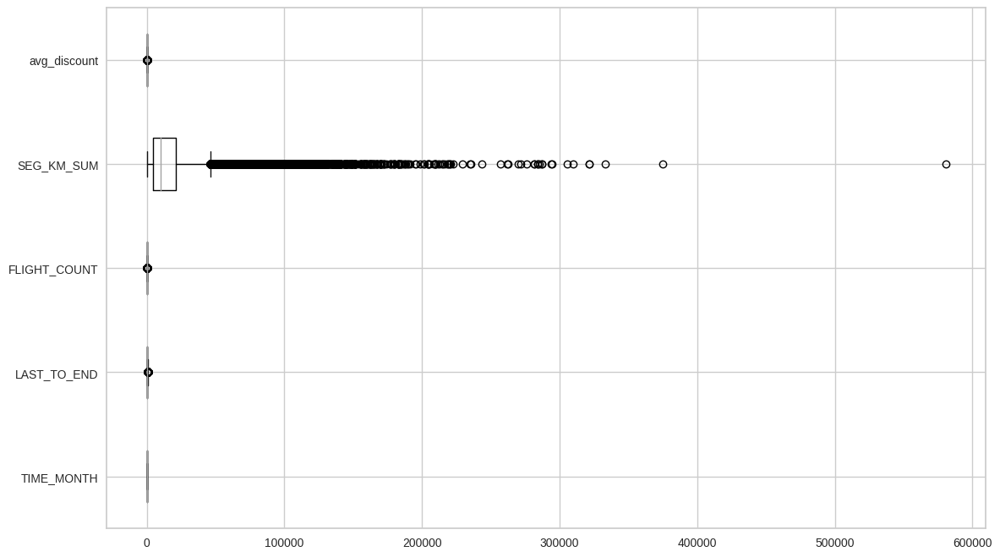

In [75]:
# Outlier Analysis

# Plotting the boxplot for the selected subset
plt.figure(figsize=(16, 8))
df_feats.boxplot(vert=False)
plt.subplots_adjust(left=0.25)
plt.show()

In [76]:
# Initialize a copy of the DataFrame to apply IQR filtering
filtered_data = df_feats.copy()

# Record the number of rows before filtering
rows_before = df_feats.shape[0]

# Apply IQR filtering for each numerical column
for col in df_feats.columns:
    Q1 = df_feats[col].quantile(0.25)
    Q3 = df_feats[col].quantile(0.75)
    IQR = Q3 - Q1
    filter = (df_feats[col] >= (Q1 - 1.5 * IQR)) & (df_feats[col] <= (Q3 + 1.5 * IQR))
    filtered_data = filtered_data[filter]

# Record the number of rows after filtering
rows_after = filtered_data.shape[0]

# Display the number of rows before and after applying IQR
rows_before, rows_after

(62981, 53131)

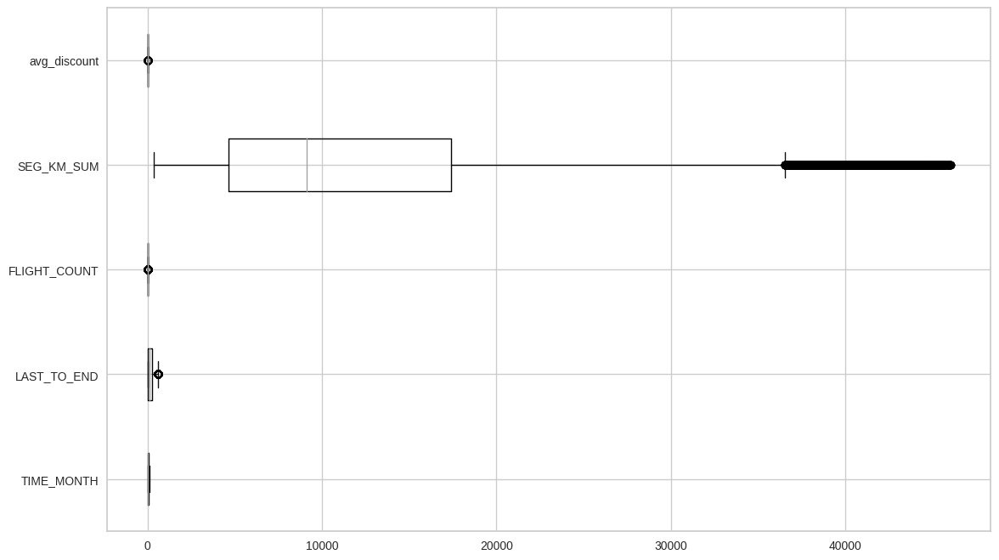

In [77]:
# Outlier Analysis

# Plotting the boxplot for the selected subset
plt.figure(figsize=(16, 8))
filtered_data.boxplot(vert=False)
plt.subplots_adjust(left=0.25)
plt.show()

#### 4. Feature Scaling

In [78]:
filtered_data.describe()

,TIME_MONTH,LAST_TO_END,FLIGHT_COUNT,SEG_KM_SUM,avg_discount
count,53131.000000,53131.000000,53131.000000,53131.000000,53131.000000
mean,47.690971,174.093429,8.718394,12330.321432,0.699431
std,27.836095,166.060429,7.009379,9893.933829,0.145555
min,12.000000,1.000000,2.000000,368.000000,0.316012
25%,23.000000,37.000000,3.000000,4644.000000,0.603166
50%,40.000000,118.000000,6.000000,9140.000000,0.702405
75%,70.000000,266.000000,12.000000,17400.000000,0.797583
max,114.000000,624.000000,33.000000,46043.000000,1.105398


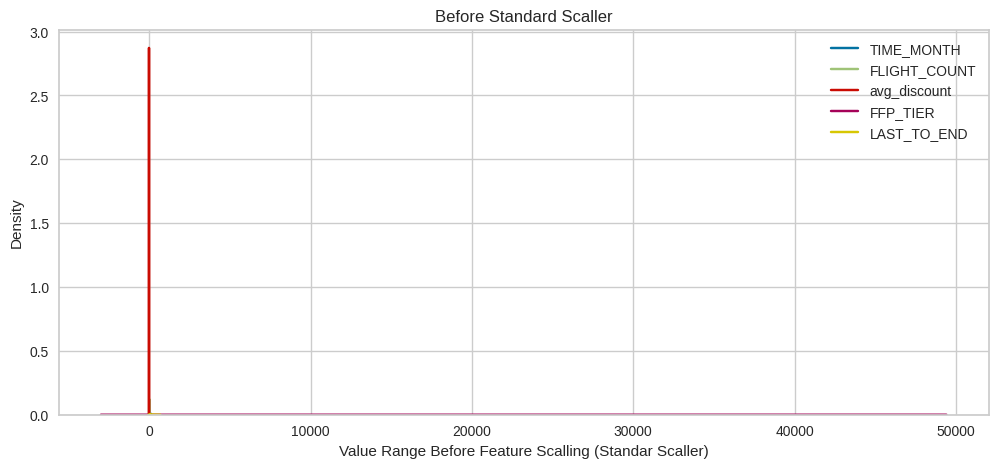

In [79]:
# A glimpse of data distribution before and after scaling, take sample only for 5 variables
fig, (ax1) = plt.subplots(ncols=1, figsize=(12, 5))

# Plot distribution after scaling
ax1.set_title('Before Standard Scaller')
sns.kdeplot(filtered_data['TIME_MONTH'], ax=ax1, label='TIME_MONTH')
sns.kdeplot(filtered_data['FLIGHT_COUNT'], ax=ax1, label='FLIGHT_COUNT')
sns.kdeplot(filtered_data['avg_discount'], ax=ax1, label='avg_discount')
sns.kdeplot(filtered_data['SEG_KM_SUM'], ax=ax1, label='FFP_TIER')
sns.kdeplot(filtered_data['LAST_TO_END'], ax=ax1, label='LAST_TO_END')

ax1.set_xlabel('Value Range Before Feature Scalling (Standar Scaller)')

# Show legend
ax1.legend()

plt.show()

In [80]:
fitur_columns = ['TIME_MONTH', 'FLIGHT_COUNT', 'avg_discount', 'SEG_KM_SUM','LAST_TO_END']
X = filtered_data[fitur_columns].values

In [81]:
# Feature Scalling
from sklearn.preprocessing import StandardScaler
X_std = StandardScaler().fit_transform(X)
df_scaling = pd.DataFrame(data = X_std, columns = fitur_columns )
df_scaling.describe()

,TIME_MONTH,FLIGHT_COUNT,avg_discount,SEG_KM_SUM,LAST_TO_END
count,5.313100e+04,5.313100e+04,5.313100e+04,5.313100e+04,5.313100e+04
mean,-7.275136e-17,1.711797e-17,3.338004e-16,-6.847187e-17,6.847187e-17
std,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00
min,-1.282195e+00,-9.584954e-01,-2.634216e+00,-1.209068e+00,-1.042362e+00
25%,-8.870211e-01,-8.158281e-01,-6.613725e-01,-7.768794e-01,-8.255713e-01
50%,-2.762975e-01,-3.878261e-01,2.043376e-02,-3.224553e-01,-3.377924e-01
75%,8.014500e-01,4.681780e-01,6.743373e-01,5.124075e-01,5.534578e-01
max,2.382146e+00,3.464192e+00,2.789127e+00,3.407441e+00,2.709320e+00


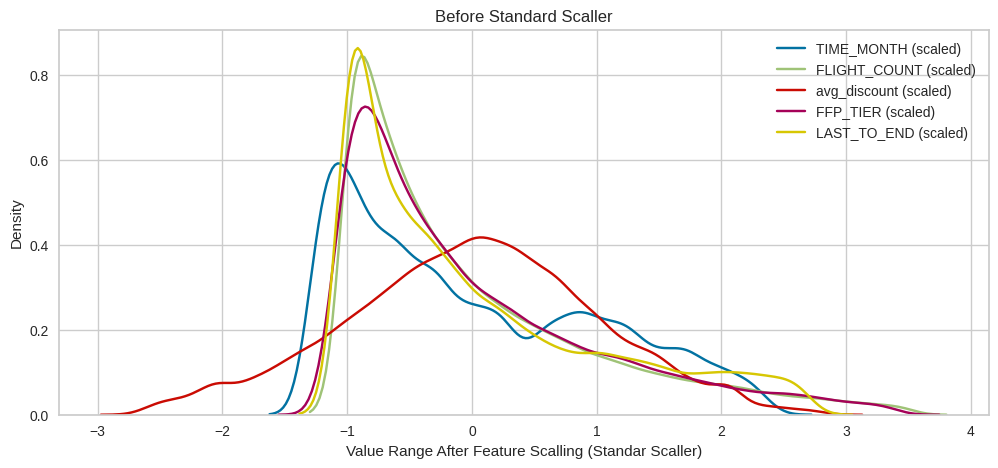

In [82]:
# A glimpse of data distribution before and after scaling, take sample only for 5 variables
fig, (ax1) = plt.subplots(ncols=1, figsize=(12, 5))

ax1.set_title('Before Standard Scaller')
sns.kdeplot(df_scaling['TIME_MONTH'], ax=ax1, label='TIME_MONTH (scaled)')
sns.kdeplot(df_scaling['FLIGHT_COUNT'], ax=ax1, label='FLIGHT_COUNT (scaled)')
sns.kdeplot(df_scaling['avg_discount'], ax=ax1, label='avg_discount (scaled)')
sns.kdeplot(df_scaling['SEG_KM_SUM'], ax=ax1, label='FFP_TIER (scaled)')
sns.kdeplot(df_scaling['LAST_TO_END'], ax=ax1, label='LAST_TO_END (scaled)')

ax1.set_xlabel('Value Range After Feature Scalling (Standar Scaller)')

# Show legend
ax1.legend()

plt.show()

## Assignment 4: RFM with K-Means
1. Use the columns 'LAST_TO_END', 'FLIGHT_COUNT', 'SEG_KM_SUM'. No need to extract data from specific columns. **With the following RFM description**:
- Recency (R) = Last_to_end column
- Frequency (F) = flight_count column
- Monetary (M) = column SEG_KM_SUM
2. Make sure the column has been carried out by StandardScaller
3. If you want to remove outliers, please just use IQR
4. Use the Elbow Method for K-Means or the Silhouette method

In [83]:
# change features name
df_scaling.columns =['L', 'R', 'F', 'M', 'C']
df_scaling.sample(5)

,L,R,F,M,C
16078,-0.635547,0.040176,0.514096,0.135911,-0.199287
15478,-0.599622,0.610845,1.295704,-0.006097,-0.964076
617,-1.246270,2.750855,0.743574,2.591883,-0.946010
49377,-1.282195,-0.815828,-1.923370,-0.880277,0.619699
12225,-0.491847,0.468178,-0.010040,0.621162,-0.933967


### Create RFM With K-Means

#### Modeling with Elbow Method and Silhoutte Score

To find the optimal number of clusters in the dataset, n-cluster analysis was carried out using the elbow method and silhouette score.

##### Elbow Method: Inertia & Distortion Score

In [84]:
import seaborn as sns
from sklearn.cluster import KMeans

from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer # Gunakan ini untuk PR atau boleh memakai KElbowVisualizer serta bisa dibandingkan hasilnya
# referensi : https://www.scikit-yb.org/en/latest/api/cluster/elbow.html

In [85]:
# find value k optimal with parameter inertia
inertia = []
k_values = range(2,11)

# fit model
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_scaling)
    inertia.append(kmeans.inertia_)

Text(0, 0.5, 'Inertia')

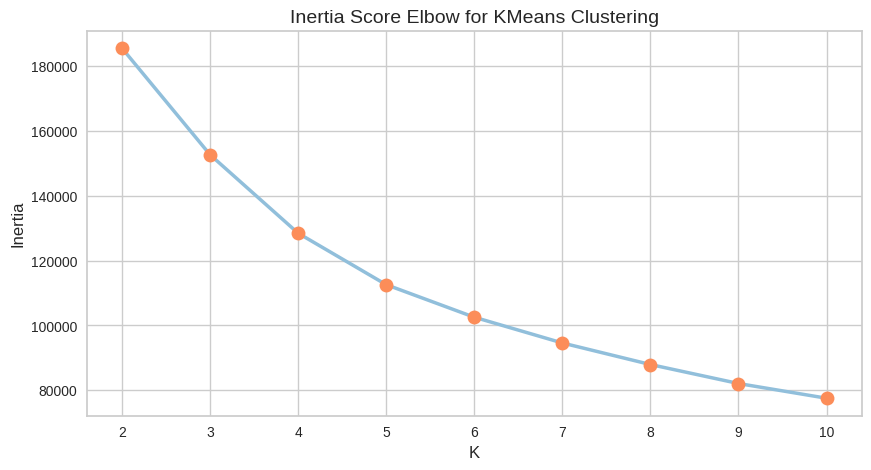

In [86]:
# Visualize graph elbow method
plt.figure(figsize=(10, 5))

# plot grah
plt.plot(k_values, inertia ,color='#91bfdb', linewidth= 2.5, marker='o', markerfacecolor='#fc8d59', markersize=10)
plt.title('Inertia Score Elbow for KMeans Clustering', fontsize=14)
plt.xlabel('K',fontsize=12)
plt.ylabel('Inertia',fontsize=12)

Based on the resulting graph, there are no sharp drops or breaks in value, so the optimal value of k is not yet clear certainty.

In [87]:
# further analysis with the percentage of inertia
(pd.Series(inertia) - pd.Series(inertia).shift(-1)) / pd.Series(inertia) * 100

0    17.721070
1    15.866257
2    12.369200
3     8.924504
4     7.756641
5     7.035077
6     6.671202
7     5.531184
8          NaN
dtype: float64

From the substract in the result values, the optimal k value is between 2-4.

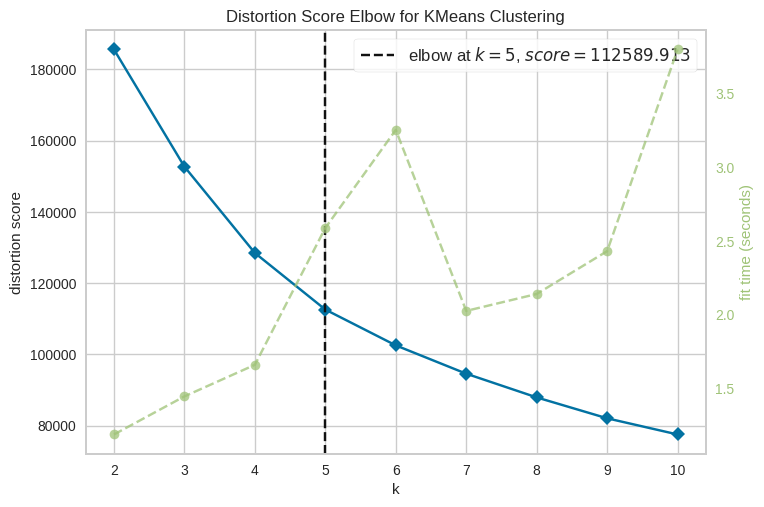

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [88]:
# visualize innertia vs k with parameter distortion
# fit model
model = KMeans(random_state=42)
visualizer = KElbowVisualizer(model, k=(2,11), metric='distortion', timings=True, locate_elbow=True)
visualizer.fit(df_scaling)
visualizer.show()

From graph above, with parameter distortion the optimal value k = 5.

##### Silhouette Score

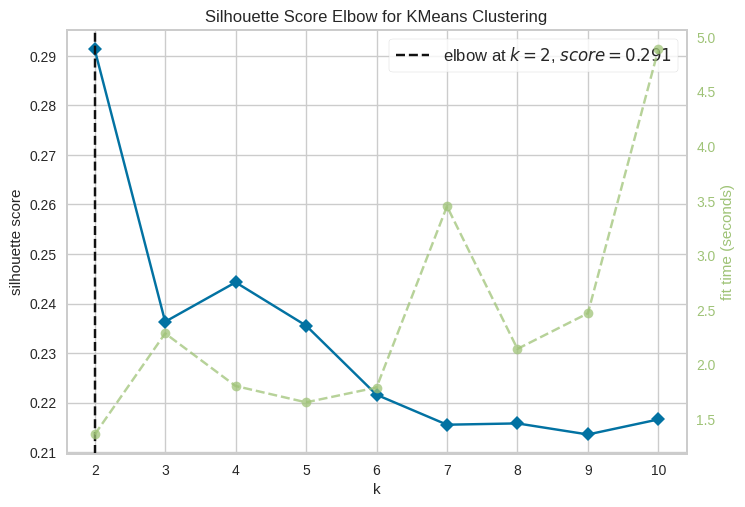

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [89]:
model = KMeans(random_state=42)
visualizer = KElbowVisualizer(model, k=(2,11), metric='silhouette', timings=True, locate_elbow=True)
visualizer.fit(df_scaling)
visualizer.show()

Based on the results above, it was found that many optimal clusters were formed at k = 2. Meanwhile, the second option was at k = 5. Because the average value of the silhouettes was the highest compared to the others.

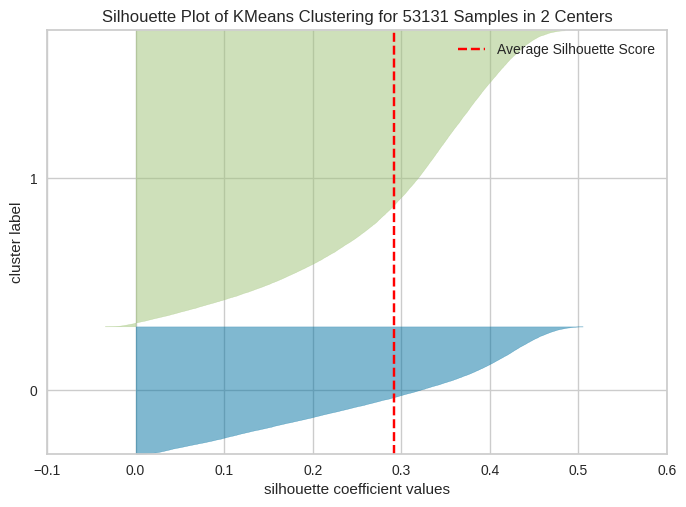

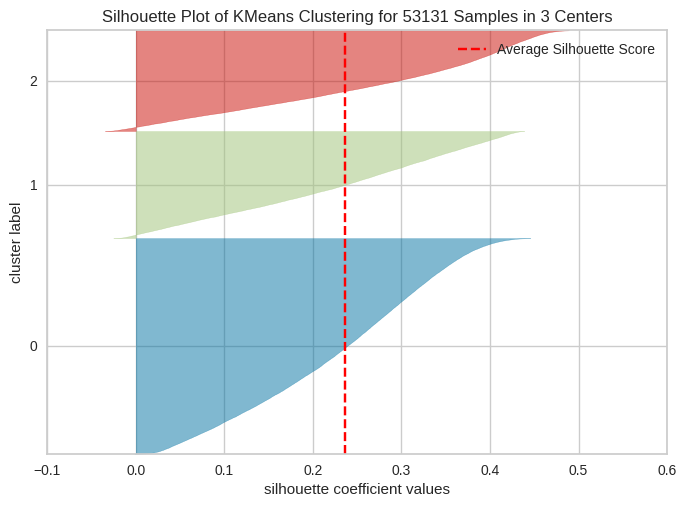

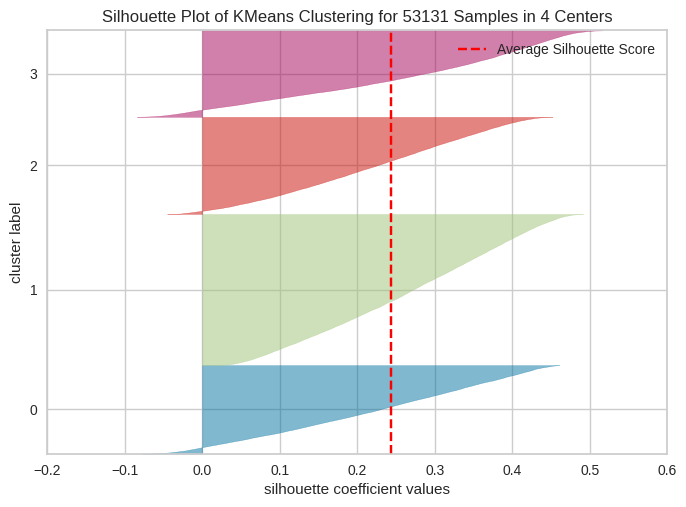

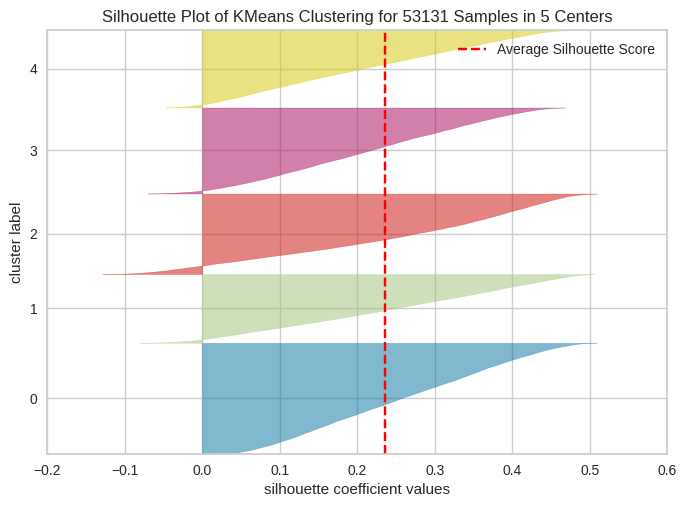

In [90]:
# silhouette plot
for i in [2,3,4,5]:
    model = KMeans(i, random_state=42)
    visualizer = SilhouetteVisualizer(model, colors='yellowbrick')
    visualizer.fit(df_scaling)
    visualizer.show()

Based on the results of the silhouette plot, to determine the best k value, we must consider two factors, namely the average coefficient as large as possible, but still smaller than the maximum score of each cluster member and considering the thickness of clusters that are similar to each other, which indicates a balanced composition.

Based on previous analysis considerations, k = 5 was chosen for n-clusters in the K-Means analysis.

#### K-Means Clustering

In [91]:
kmeans_model = KMeans(
    n_clusters = 5, #5 from evaluation via score above
    random_state=42
)

kmeans_model.fit(df_scaling) #k-means is trained into df_scaling

KMeans(n_clusters=5, random_state=42)

In [92]:
#Assign cluster to 'cluster' column
df_scaling['cluster_elbow'] = kmeans_model.labels_
df_scaling.head(20)

,L,R,F,M,C,cluster_elbow
0,1.519948,2.893523,2.749066,3.179724,-0.952032,2
1,0.873300,-0.102491,2.358327,3.363070,-0.398012,2
2,-0.132598,2.893523,2.472447,3.204284,-1.006230,2
3,1.088849,-0.387826,2.200449,3.348515,1.577191,2
4,0.190726,1.324182,2.336821,3.258965,-0.114980,2
5,1.663648,2.180186,2.661186,3.024273,-1.024296,2
6,1.591798,2.893523,2.093503,3.306065,-0.946010,2
7,-0.599622,1.894851,2.714527,2.918652,-1.006230,2
8,1.304399,-0.102491,2.703597,2.910667,1.390510,2
9,0.298501,-0.102491,2.112917,3.260279,-0.108958,2


Text(0.5, 1.0, 'Total Customer for Each Segment')

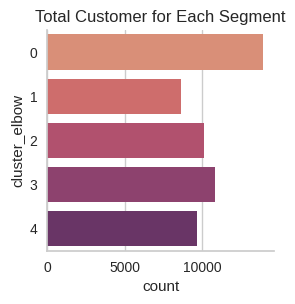

In [93]:
sns.catplot(
    y = 'cluster_elbow',
    data = df_scaling,
    kind = 'count',
    palette = "flare",
    height = 3
).ax.set_title("Total Customer for Each Segment")

By using this plot, we can see the distribution of the number of customers in each previously defined cluster segment.

This information helps to understand the distribution of customers within each segment and can provide important insights into the characteristics each customer group may have.

#### Evaluation using PCA dan Visualization

1. **Visualizing Clusters**:
K-Means clustering works in multidimensional space, which can be impossible to visualize directly when we have more than three dimensions.
By using PCA to project the data into two or three principal components, we can plot the clusters in 2D or 3D space, which is much more intuitive to interpret.

2. **Computational Efficiency**:
If K-Means is performed after PCA, the lower-dimensional space can also speed up the computations, as distance calculations are less costly when there are fewer dimensions.

In [94]:
## do PCA to see the visualization
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

pca.fit(df_scaling)
pcs = pca.transform(df_scaling)


df_pca = pd.DataFrame(data = pcs, columns = ['PC 1', 'PC 2'])
df_pca['cluster'] = df_scaling['cluster_elbow']
df_pca

,PC 1,PC 2,cluster
0,-0.632922,4.640814,2
1,-0.611138,2.495548,2
2,-0.911431,4.395888,2
3,-0.594071,1.449790,2
4,-0.801927,3.089614,2
5,-0.549626,4.146527,2
6,-0.342555,4.675996,2
7,-1.112731,3.539358,2
8,-0.749693,1.516581,2
9,-0.663355,2.193249,2


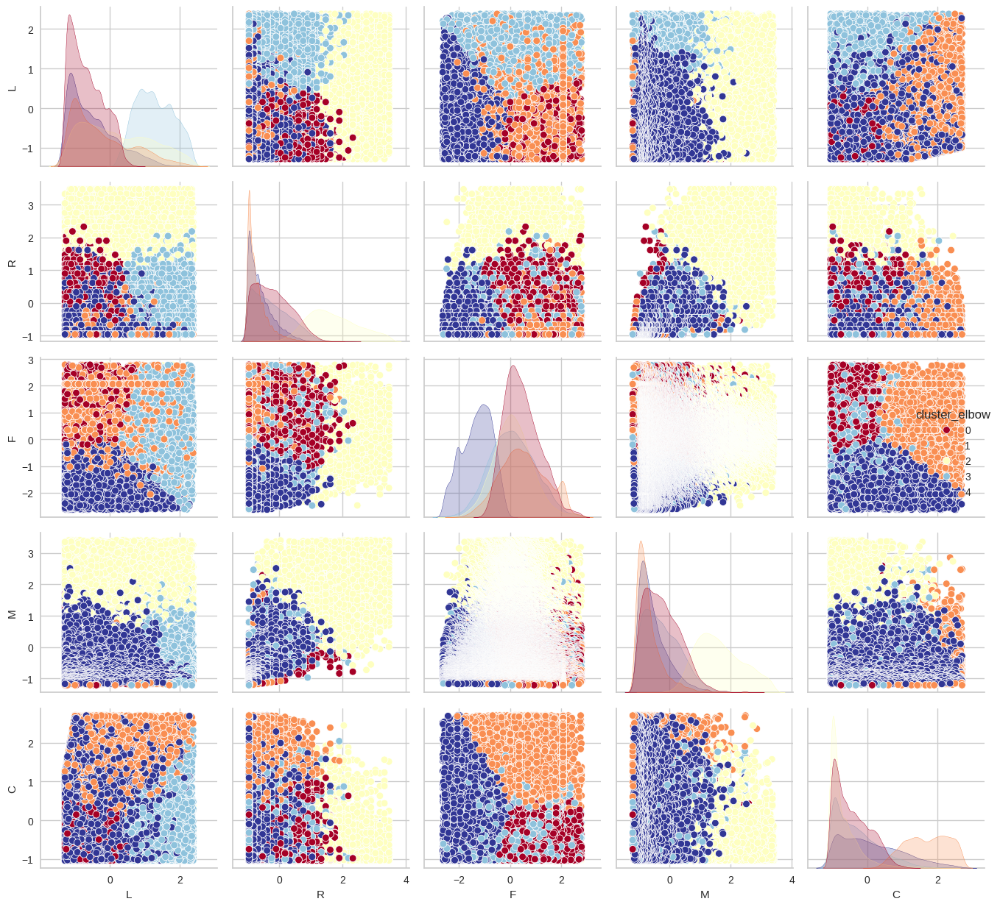

In [95]:
# visualize with pairplot
sns.pairplot(data=df_scaling, hue='cluster_elbow', diag_kind='kde', palette='RdYlBu')
plt.tight_layout()

Text(0.5, 1.0, 'Customer Segmentation Based on Loyalty, Recency, Frequency, Monetary, and DisCount Model')

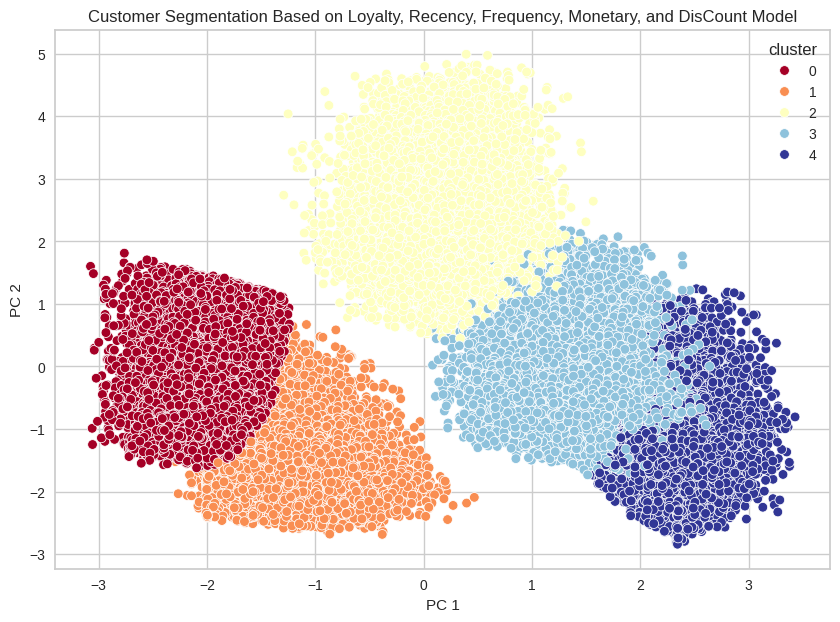

In [96]:
# visualize segmentation result
fig, ax = plt.subplots(figsize=(10,7))
sns.scatterplot(data=df_pca, x="PC 1", y="PC 2", hue="cluster", palette='RdYlBu')
plt.title('Customer Segmentation Based on Loyalty, Recency, Frequency, Monetary, and DisCount Model')

 The clusters are visually distinct, indicating that the PCA and clustering have found clear groupings in the data. The fact that the clusters do not overlap much in the two principal component dimensions suggests that the PCA transformation has maintained a good separation of the clusters, which were likely identified in the original multi-dimensional space.

## Assignment 5: Insight and Interpretation of RFM results
1. Interpret business and also the results of k-means, plotting each recency, frequency, monetary in an interesting way so that it is easy to digest when taking insights, for example using radar plot, bar plot, box plot, or other plots that you think are informative.

### Add Cluster to DataFrame (before standarize)

In [97]:
# adding cluster to dataframe
filtered_data['cluster_elbow'] = kmeans_model.labels_
display(filtered_data.groupby('cluster_elbow').agg(['mean','median','min','max']))

TIME_MONTH                 LAST_TO_END                   \
                    mean median min  max        mean median  min  max   
cluster_elbow                                                           
0              29.385704   27.0  12   70  102.963865   84.0    1  390   
1              41.195919   35.0  12  114  456.478089  461.0  203  624   
2              53.405545   49.0  12  114   61.909307   34.0    1  581   
3              83.417778   82.0  52  114  123.900370  102.0    1  561   
4              33.986164   30.0  12  111  197.781415  172.0    1  624   

              FLIGHT_COUNT                   SEG_KM_SUM                        \
                      mean median min max          mean   median   min    max   
cluster_elbow                                                                   
0                 7.450287    7.0   2  25  10146.647342   9384.5   368  40376   
1                 3.855089    3.0   2  22   5688.575701   4322.5   368  40582   
2                20.305050   20.0   3  33  28465.872376  27469.0  5152  46043   
3                 7.060648    6.0   2  24   9986.794537   9099.5   368  38854   
4                 4.637997    4.0   2  20   7170.741456   5826.0   716  37162   

              avg_discount                                
                      mean    median       min       max  
cluster_elbow                                             
0                 0.766071  0.752815  0.535239  1.105000  
1                 0.774103  0.766559  0.392958  1.105398  
2                 0.713284  0.709122  0.339656  1.104798  
3                 0.711830  0.707679  0.317766  1.104221  
4                 0.508872  0.517897  0.316012  0.700774

### Percentage of Customer in Each Cluster

In [98]:
# percentage customers each cluster
cluster_count = filtered_data['cluster_elbow'].value_counts().reset_index()
cluster_count.columns = ['cluster_elbow', 'count']
cluster_count['percentage (%)'] = round((cluster_count['count']/len(filtered_data))*100,2)
cluster_count = cluster_count.sort_values(by=['cluster_elbow']).reset_index(drop=True)
cluster_count

,cluster_elbow,count,percentage (%)
0,0,13920,26.20
1,1,8626,16.24
2,2,10100,19.01
3,3,10800,20.33
4,4,9685,18.23


Text(0, 0.5, 'Percentage')

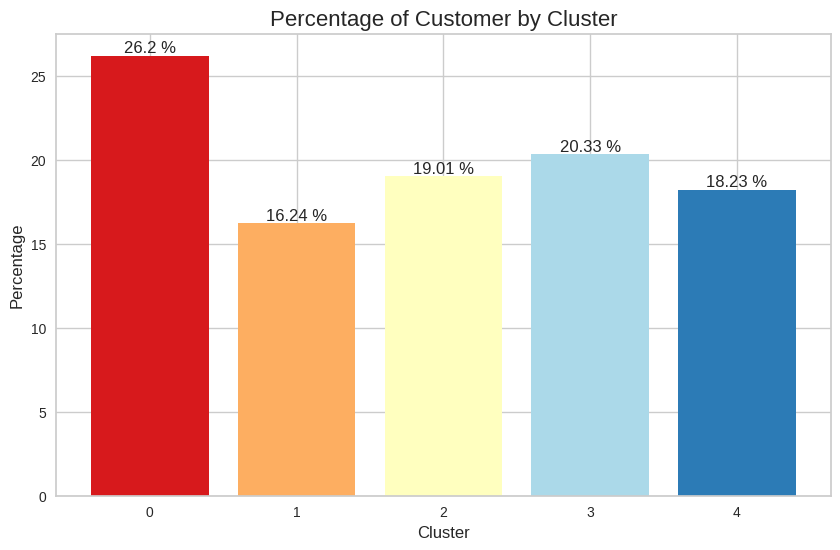

In [99]:
#visualize percentage of customer in each cluster
fig, ax = plt.subplots(figsize=(10,6))

c = ["#d7191c","#fdae61","#ffffbf","#abd9e9","#2c7bb6"]
bars = plt.bar(x=cluster_count['cluster_elbow'], height= cluster_count['percentage (%)'],color=c)

for bar in bars:
  height = bar.get_height()
  label_x_pos = bar.get_x() + bar.get_width() / 2
  ax.text(label_x_pos, height, s=f'{height} %', ha='center',
  va='bottom')
plt.title('Percentage of Customer by Cluster', fontsize=16)
plt.xlabel('Cluster',fontsize=12)
plt.ylabel('Percentage',fontsize=12)

### Customer Segmentation Analysis

In [100]:
df_scaling.head(5)

,L,R,F,M,C,cluster_elbow
0,1.519948,2.893523,2.749066,3.179724,-0.952032,2
1,0.873300,-0.102491,2.358327,3.363070,-0.398012,2
2,-0.132598,2.893523,2.472447,3.204284,-1.006230,2
3,1.088849,-0.387826,2.200449,3.348515,1.577191,2
4,0.190726,1.324182,2.336821,3.258965,-0.114980,2


In [101]:
# change features name
df_scaling.columns =['L', 'R', 'F', 'M', 'C', 'cluster']
df_scaling.sample(5)

,L,R,F,M,C,cluster
41016,-0.994796,-0.958495,-0.601504,-0.767278,1.065324,4
16605,-1.210345,0.040176,-1.136680,0.700909,-0.319727,4
23822,0.873300,-0.815828,1.783391,-0.492965,0.396887,3
17045,0.442201,0.182843,-0.266747,0.290451,-0.855681,3
28610,-0.635547,-0.387826,-0.294958,-0.378147,-0.187243,0


Text(0, 0.5, 'Value')

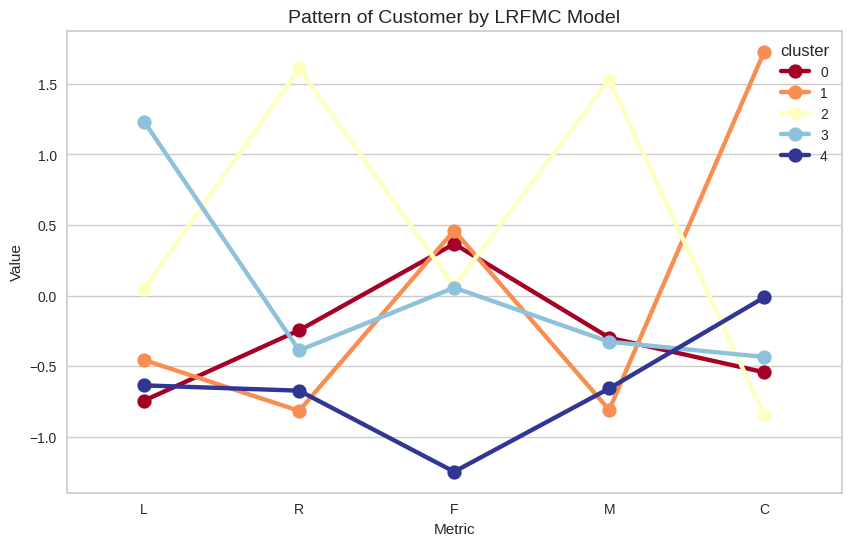

In [102]:
# Seeing pattern of LRFMC in every cluster
cluster_med = df_scaling.groupby('cluster')[['L', 'R', 'F', 'M', 'C']].median().reset_index()

df_melt = pd.melt(cluster_med.reset_index(), id_vars='cluster', value_vars=['L', 'R', 'F','M','C'], var_name='Metric', value_name='Value')

plt.figure(figsize=(10,6))
sns.pointplot(data=df_melt, x='Metric', y='Value', hue='cluster', palette='RdYlBu')
plt.title('Pattern of Customer by LRFMC Model', fontsize=14)
plt.xlabel('Metric')
plt.ylabel('Value')

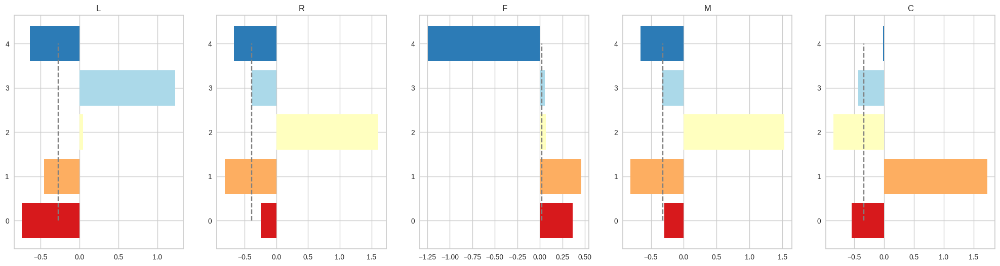

In [103]:
# looking at the average LRFMC variable between clusters
LRFMC= ['L','R','F','M','C']
def dist_list(lst):
    plt.figure(figsize=[len(lst)*5,6])
    i = 1
    for col in lst:
        ax = plt.subplot(1,len(lst),i)
        ax.vlines(df_scaling[col].median(), ymin=0, ymax=4, color='grey', linestyle='--')
        g = df_scaling.groupby('cluster')
        x = g[col].median().index
        y = g[col].median().values
        ax.barh(x,y, color=c)
        plt.title(col)
        i = i+1

dist_list(LRFMC)

Overall, these clusters were formed due to differences in LRFMC model indicators. Based on the results of the analysis and visualization, the characteristics of customers in each group can be identified as follows:

In [104]:
# Calculate median values for each cluster
cluster_medians = df_scaling.groupby('cluster')['L', 'R', 'F', 'M', 'C'].median().reset_index()

# Initialize a DataFrame to store the high, average, and low value accumulations
cluster_accumulation = pd.DataFrame(columns=['Cluster', 'High Value', 'Average Value', 'Low Value'])

# For each cluster, identify which LRFMC variables are high, average, or low
for i in cluster_medians['cluster'].unique():
    cluster_data = cluster_medians[cluster_medians['cluster'] == i]

    # Extract median values for the cluster
    medians = cluster_data.iloc[0, 1:]
    high = medians[medians == medians.max()].index.tolist()
    low = medians[medians == medians.min()].index.tolist()
    # Average here, we just take those not high or low
    average = medians[(medians != medians.max()) & (medians != medians.min())].index.tolist()

    # Add the accumulation data for the cluster to the DataFrame
    cluster_accumulation = cluster_accumulation.append({
        'Cluster': 'Cluster ' + str(i),
        'High Value': ' '.join(high),
        'Average Value': ' '.join(average),
        'Low Value': ' '.join(low)
    }, ignore_index=True)

# Show the result
cluster_accumulation


,Cluster,High Value,Average Value,Low Value
0,Cluster 0,F,R M C,L
1,Cluster 1,C,L F M,R
2,Cluster 2,R,L F M,C
3,Cluster 3,L,R F M,C
4,Cluster 4,C,L R M,F


### **Interpretation**

1. **Cluster 0 - Loyal Infrequents**
  * A group of customers who fly frequently (high frequency value) but do not spend significantly (average monetary value) nor do they take advantage of discounts often (average discount value). The loyalty is low, suggesting they are not deeply committed to the airline despite their frequent travels. They have an average time since their last flight (average recency), indicating they use the airline consistently but are not recently engaged.

2. **Cluster 1 - Discount Conscious**
  * Customers in Cluster 1 look for discounts (high discount value) and have a moderate level of loyalty, frequency, and spending (average values for loyalty, frequency, and monetary). However, they haven't flown recently (low recency), suggesting they may choose flights based on the availability of discounts rather than brand loyalty or need.

3. **Cluster 2 - Potential Loyalist**
  * Cluster 2's customers have flown recently (high recency value) and show a decent level of loyalty, frequency of flights, and spending (all average values), but they are not drawn by discounts (low discount value). These customers might be newer or returning customers who are beginning to engage more with the airline.

4. **Cluster 3 - Loyal and Stable**
  * Customers in Cluster 3 are highly loyal (high loyalty value) with average recency, frequency, and monetary values, indicating they have a steady relationship with the airline but are not influenced much by discounts (low discount value). They fly at a consistent rate and spend a consistent amount, which could make them a reliable source of revenue.
  
5. **Cluster 4 - Bargain Flyers**
  * In Cluster 4, customers are highly motivated by discounts (high discount value) but fly infrequently (low frequency value). Their loyalty, recency, and monetary values are average, suggesting they have an average relationship with the airline in terms of time since last flight, overall spending, and commitment. They may fly more if the right promotions are offered.

## References:

[1] Tao, Y.: Analysis Method for Customer Value of Aviation Big Data Based on LFRMC Model. ICPCSEE 2020, CCIS 1257. 89-100(2020)